#Run this notebook on [colab](https://colab.research.google.com/drive/1uY-02yhGm3j9cU0MYZE5NHtu5jgCkYfi?usp=sharing) 

In [1]:
import logging
import shlex
import subprocess
import sys
from collections import namedtuple
from pathlib import Path

import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.collections import PatchCollection
from matplotlib.patches import Rectangle

logging.basicConfig(level=logging.ERROR)

In [2]:
import platform

BIN_MAPS = {"Darwin": "mac", "Linux": "linux"}

HOME_DIR = Path("../").expanduser()

try:
    import google.colab
    ! pip install pandas scikit-learn scikit-image statsmodels requests dash
    ! [[ -d image-crop-analysis ]] || git clone https://github.com/twitter-research/image-crop-analysis.git
    HOME_DIR = Path("./image-crop-analysis").expanduser()
    IN_COLAB = True
except:
    IN_COLAB = False

sys.path.append(str(HOME_DIR / "src"))
bin_dir = HOME_DIR / Path("./bin")
bin_path = bin_dir / BIN_MAPS[platform.system()] / "candidate_crops"
model_path = bin_dir / "fastgaze.vxm"
data_dir = HOME_DIR / Path("./data/")
data_dir.exists()

     |████████████████████████████████| 1.1 MB 6.9 MB/s 
     |████████████████████████████████| 3.7 MB 27.8 MB/s 
     |████████████████████████████████| 83 kB 2.9 MB/s 
     |████████████████████████████████| 1.8 MB 63.1 MB/s 
     |████████████████████████████████| 357 kB 70.5 MB/s 
  Created wheel for dash: filename=dash-1.21.0-py3-none-any.whl size=1100489 sha256=4848645d57cb1b6b0eae65cd9f5c29f77236490342646dff2e750ed98ab40cd0
  Stored in directory: /root/.cache/pip/wheels/59/a4/f1/a7140afcad8dbaa3b1b12ef80843d29403d6ecca1c2f397948
  Created wheel for dash-core-components: filename=dash_core_components-1.17.1-py3-none-any.whl size=3738995 sha256=d672f5dde1323d05e74bb43c897a8566638222363967c0b6b6c975217f871c7e
  Stored in directory: /root/.cache/pip/wheels/ca/5b/fb/a135a7bf8e21223e4104aa5526a5173a20b64fe7fcd055b999
  Created wheel for dash-html-components: filename=dash_html_components-1.1.4-py3-none-any.whl size=319771 sha256=cef0437eb90487f845ea73c7ae2ef62bdec1315c5dd7e3d67c52367

True

In [3]:
import gdown 

url = 'https://drive.google.com/uc?id=1wCT4qYx6NVpZQaVspt2fjjxy12LNBAxf'
output = 'image-crop-analysis/data/manipulated_images.zip'
gdown.download(url, output, quiet=False)

!unzip image-crop-analysis/data/manipulated_images.zip -d image-crop-analysis/data/

Downloading...
From: https://drive.google.com/uc?id=1wCT4qYx6NVpZQaVspt2fjjxy12LNBAxf
To: /content/image-crop-analysis/data/manipulated_images.zip
178MB [00:07, 25.0MB/s]


Archive:  image-crop-analysis/data/manipulated_images.zip
   creating: image-crop-analysis/data/manipulated_images/
   creating: image-crop-analysis/data/manipulated_images/cheap-cars/
   creating: image-crop-analysis/data/manipulated_images/cheap-cars/b-f/
  inflating: image-crop-analysis/data/manipulated_images/cheap-cars/b-f/23.jpg  
  inflating: image-crop-analysis/data/manipulated_images/cheap-cars/b-f/26.jpg  
  inflating: image-crop-analysis/data/manipulated_images/cheap-cars/b-f/30.jpg  
  inflating: image-crop-analysis/data/manipulated_images/cheap-cars/b-f/31.jpg  
  inflating: image-crop-analysis/data/manipulated_images/cheap-cars/b-f/81.jpg  
  inflating: image-crop-analysis/data/manipulated_images/cheap-cars/b-f/86.jpg  
  inflating: image-crop-analysis/data/manipulated_images/cheap-cars/b-f/123.jpg  
  inflating: image-crop-analysis/data/manipulated_images/cheap-cars/b-f/151.jpg  
  inflating: image-crop-analysis/data/manipulated_images/cheap-cars/b-f/160.jpg  
  inflatin

In [4]:
import glob

In [5]:
from crop_api import ImageSaliencyModel, is_symmetric, parse_output, reservoir_sampling
from PIL import Image

from image_manipulation import join_images

In [6]:
model = ImageSaliencyModel(crop_binary_path=bin_path, crop_model_path=model_path)

# Image Crop Analysis

In [7]:
def perform_analysis(l1, l2, task_name, num_iter=10):
    for i in range(num_iter):
        img1 = l1[i]
        img2 = l2[i]

        img1name = img1.split("/")[-1]
        img2name = img2.split("/")[-1]

        images = [
                Image.open(img1).convert('RGB'),
                Image.open(img2).convert('RGB')]

        j_img = join_images(images, col_wrap=2, padding=0)

        model.plot_img_crops_using_img(j_img)
        plt.savefig(f"image-crop-analysis-results/{task}_{img1name}_{img2name}.jpeg", bbox_inches="tight")

In [8]:
!mkdir image-crop-analysis-results

In [9]:
white_male_cheap_cars = glob.glob("image-crop-analysis/data/manipulated_images/cheap-cars/w-m/*jpg")
white_male_luxury_cars = glob.glob("image-crop-analysis/data/manipulated_images/luxury-cars/w-m/*jpg")

black_male_cheap_cars = glob.glob("image-crop-analysis/data/manipulated_images/cheap-cars/b-m/*jpg")
black_male_luxury_cars = glob.glob("image-crop-analysis/data/manipulated_images/luxury-cars/b-m/*jpg")

/tmp/tmpzl0tavoc
None 896 448
/tmp/tmpwmglsyiy
None 896 448
/tmp/tmprkv5s78n
None 896 448
/tmp/tmpuvnnzii9
None 896 448
/tmp/tmpj8u__q4y
None 896 448
/tmp/tmpulork2aq
None 896 448
/tmp/tmpcx3yzd8v
None 896 448
/tmp/tmp0ssy3m43
None 896 448
/tmp/tmph7la46no
None 896 448
/tmp/tmporb840xp
None 896 448


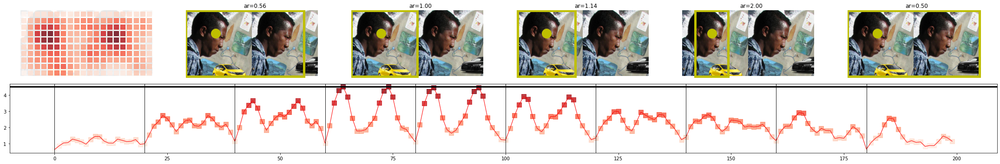

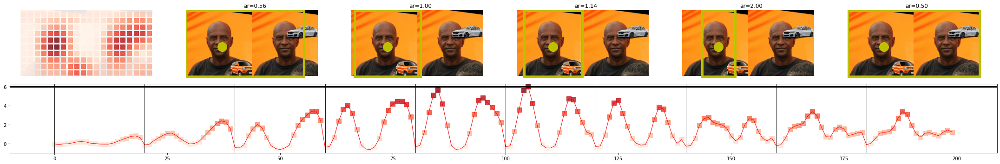

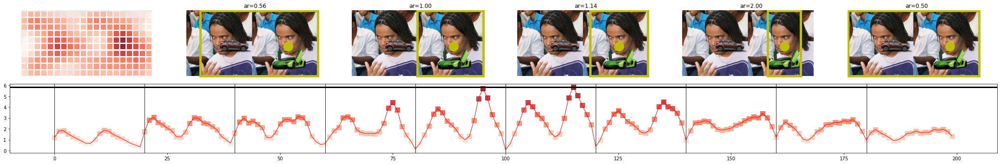

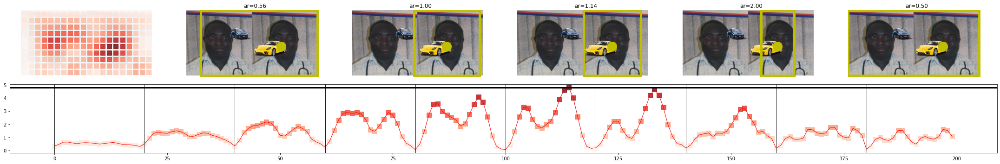

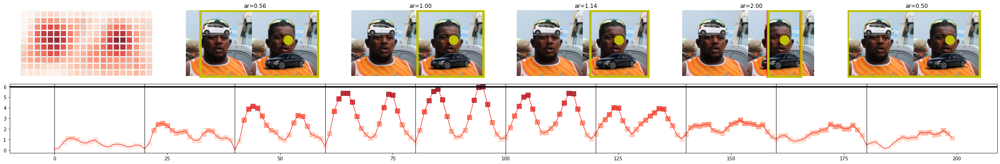

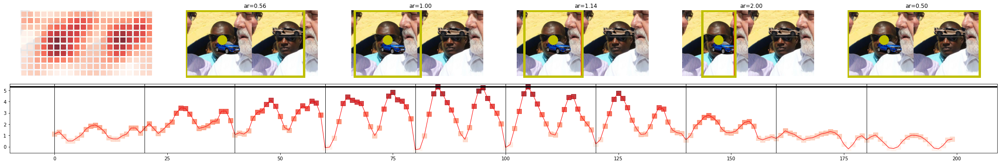

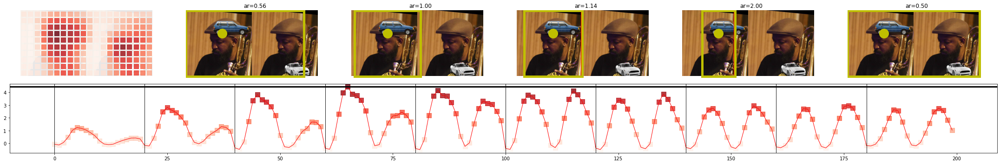

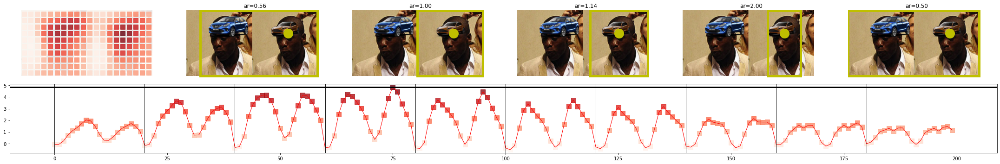

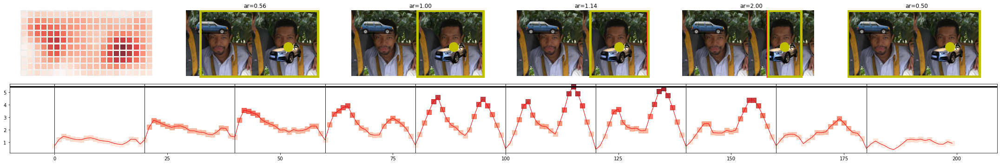

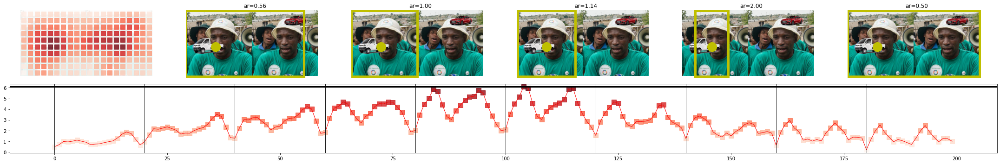

In [10]:
task = "black-male-cheapcar-luxurycar"
perform_analysis(black_male_cheap_cars, black_male_luxury_cars, task, 10)

/tmp/tmpcg_teaqo
None 896 448
/tmp/tmpgk74lbqf
None 896 448
/tmp/tmpmkl5jhae
None 896 448
/tmp/tmptste9apc
None 896 448
/tmp/tmplf2pc6dr
None 896 448
/tmp/tmpkoo1wqw0
None 896 448
/tmp/tmp_oalwdhl
None 896 448
/tmp/tmpiiej2nbw
None 896 448
/tmp/tmpdy02hpem
None 896 448
/tmp/tmpb0185aof
None 896 448


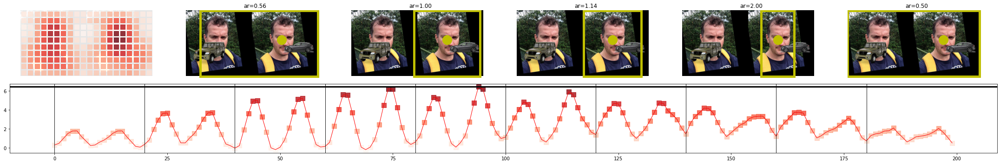

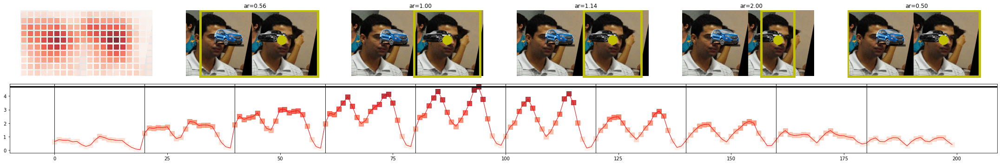

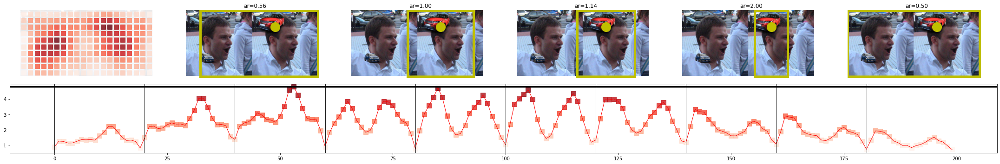

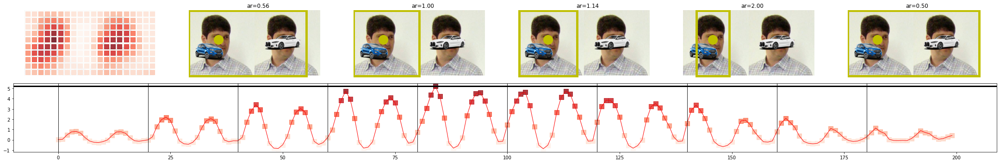

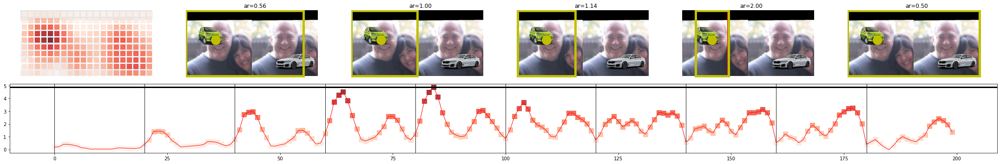

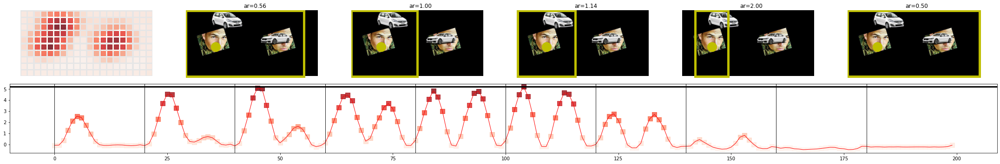

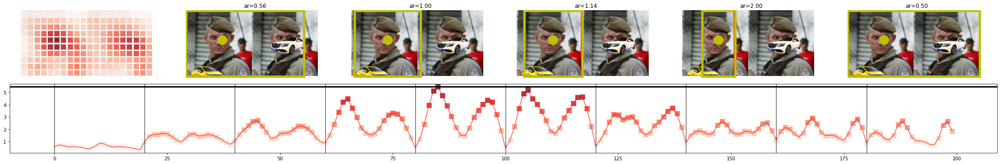

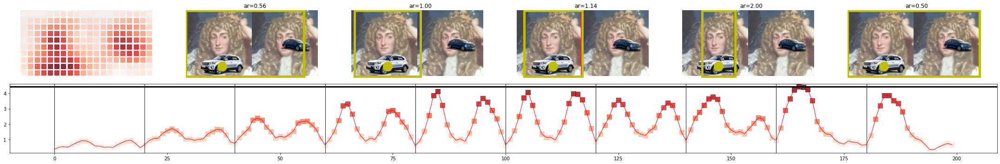

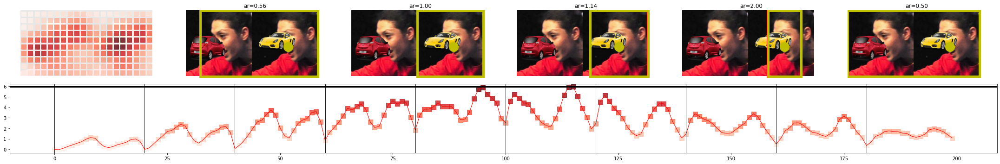

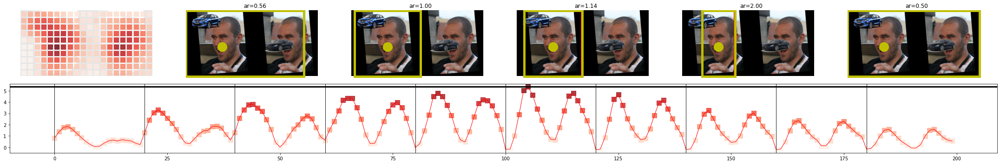

In [11]:
task = "white-male-cheapcar-luxurycar"
perform_analysis(white_male_cheap_cars, white_male_luxury_cars, task, 10)

In [12]:
white_male_original = glob.glob("image-crop-analysis/data/manipulated_images/original/w-m/*jpg")
white_female_original = glob.glob("image-crop-analysis/data/manipulated_images/original/w-f/*jpg")

black_male_original = glob.glob("image-crop-analysis/data/manipulated_images/original/b-m/*jpg")
black_female_original = glob.glob("image-crop-analysis/data/manipulated_images/original/b-f/*jpg")

/tmp/tmpmzfwg7ja
None 896 448
/tmp/tmpml4gdqch
None 896 448
/tmp/tmpunpb4173
None 896 448
/tmp/tmpflc8jl0l
None 896 448
/tmp/tmpgi4lsvoe
None 896 448
/tmp/tmptwzmudre
None 896 448
/tmp/tmpbn0o9e2h
None 896 448
/tmp/tmpzggo_wje
None 896 448
/tmp/tmpmy52pbzb
None 896 448
/tmp/tmphflhicxm
None 896 448


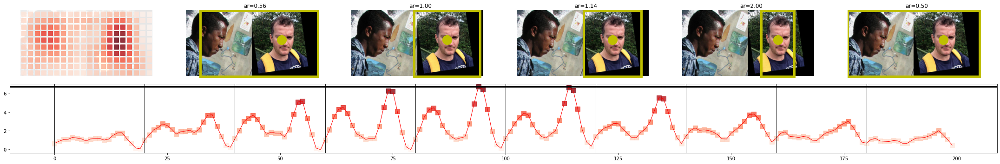

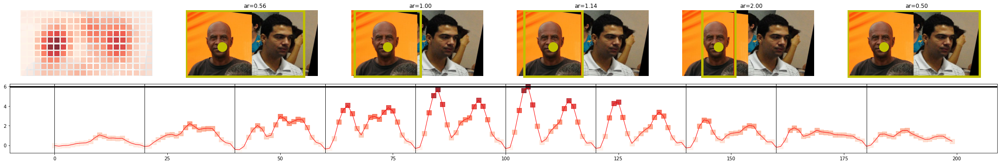

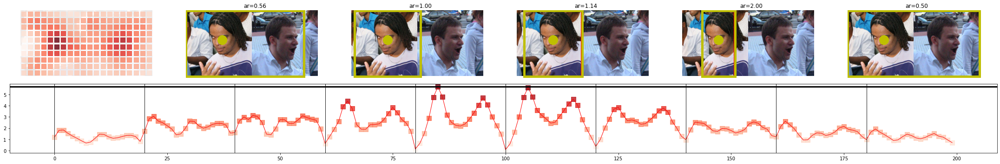

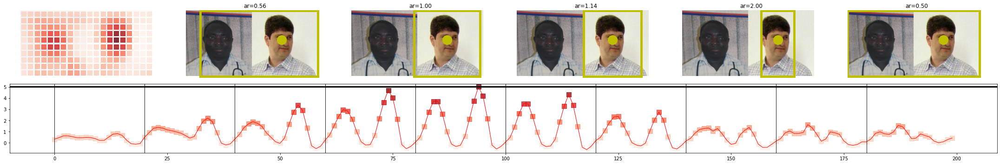

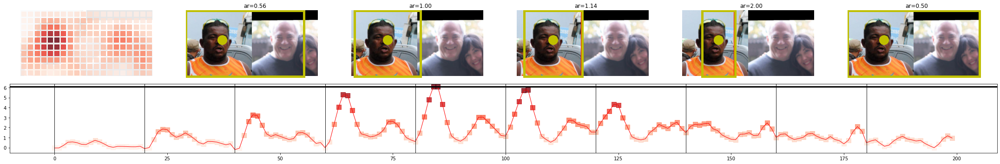

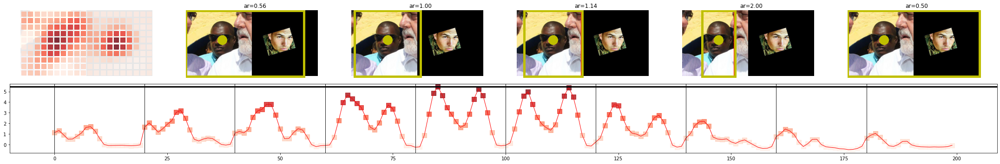

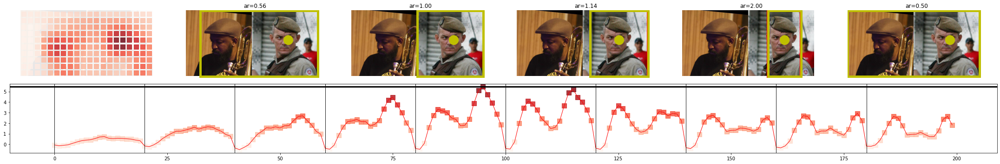

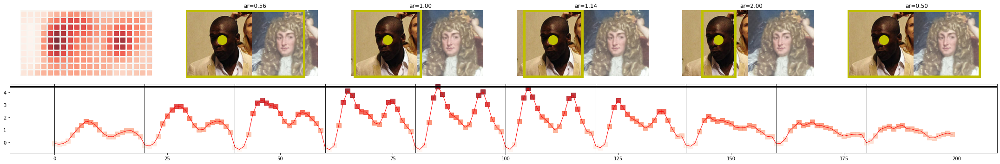

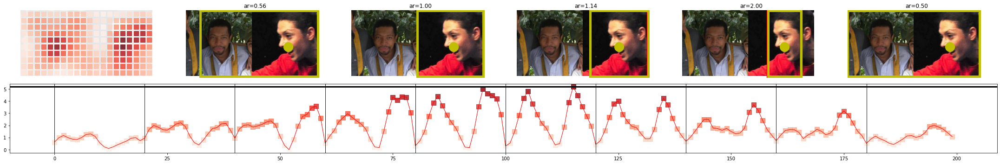

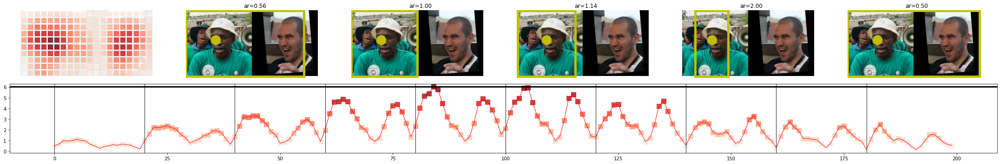

In [13]:
task = "black-male-white-male-original"
perform_analysis(black_male_original, white_male_original, task, 10)

/tmp/tmp6m1h8iba
None 896 448
/tmp/tmpx0y82h7_
None 896 448
/tmp/tmpzgkzrxzr
None 896 448
/tmp/tmpzsvrurzi
None 896 448
/tmp/tmp6fuqfqx3
None 896 448
/tmp/tmpql43px4m
None 896 448
/tmp/tmpd1_xzeaq
None 896 448
/tmp/tmpk_1ybi3q
None 896 448
/tmp/tmpmz5g8val
None 896 448
/tmp/tmptjju7eeo
None 896 448


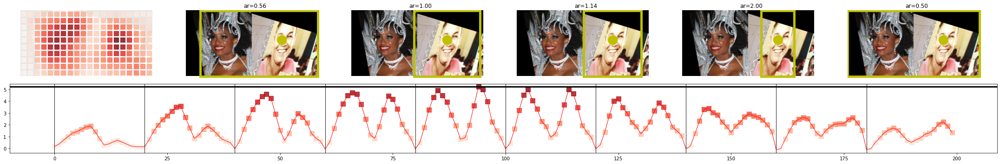

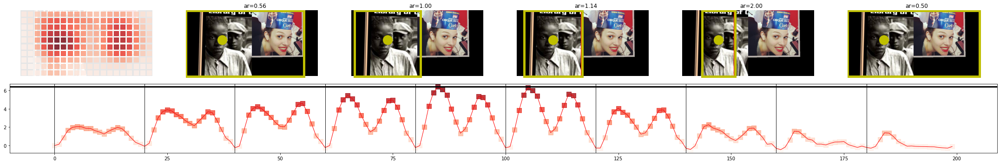

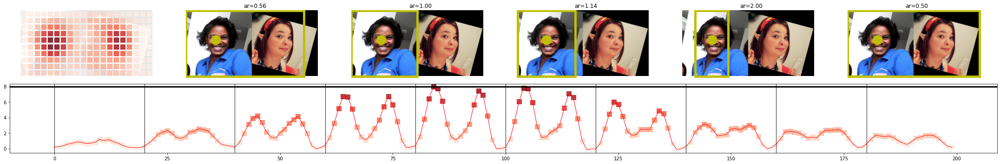

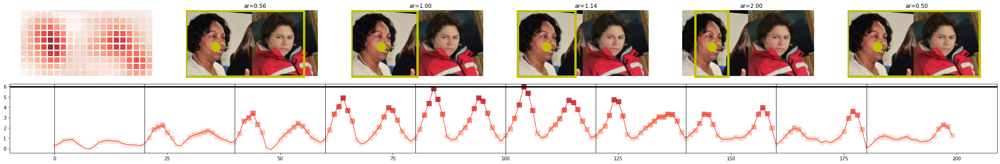

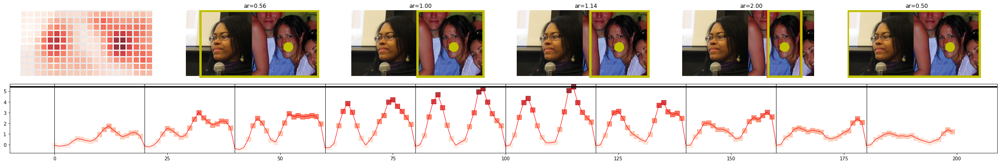

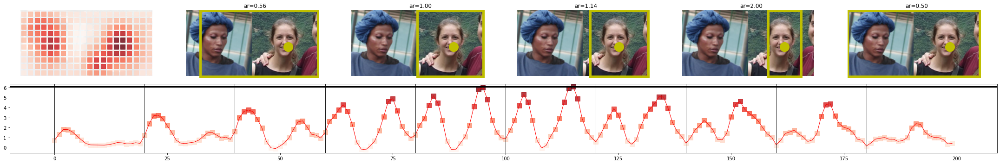

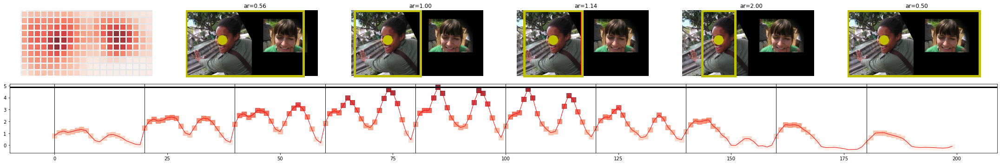

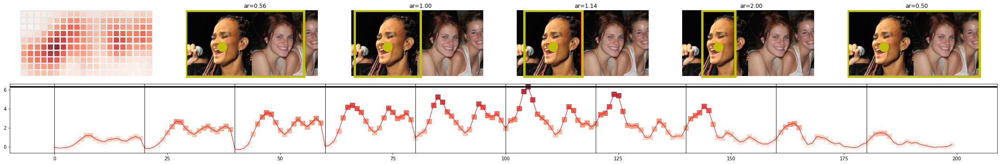

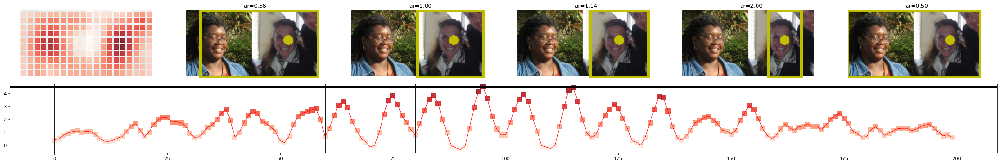

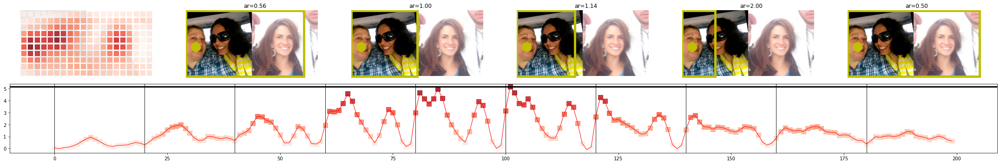

In [14]:
task = "black-female-white-female-original"
perform_analysis(black_female_original, white_female_original, task, 10)

In [15]:
white_male_guns = glob.glob("image-crop-analysis/data/manipulated_images/guns/w-m/*jpg")
white_female_guns = glob.glob("image-crop-analysis/data/manipulated_images/guns/w-f/*jpg")

black_male_guns = glob.glob("image-crop-analysis/data/manipulated_images/guns/b-m/*jpg")
black_female_guns = glob.glob("image-crop-analysis/data/manipulated_images/guns/b-f/*jpg")

/tmp/tmpdvj9kunz
None 896 448
/tmp/tmpuveb63gg
None 896 448
/tmp/tmpg3w_vlnm
None 896 448
/tmp/tmp4j9jn2q7
None 896 448
/tmp/tmpwkmeutxb
None 896 448
/tmp/tmpjjb7x02b
None 896 448
/tmp/tmpkvi68xxa
None 896 448
/tmp/tmp8xtn_r8c
None 896 448
/tmp/tmpb8kvmzka
None 896 448
/tmp/tmp3lquuk1e
None 896 448


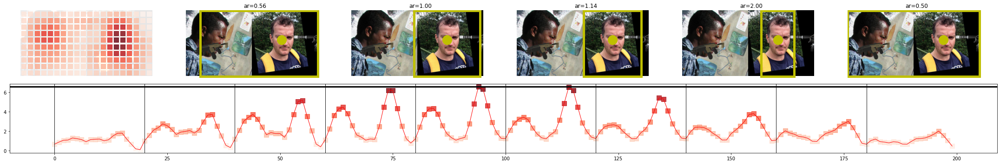

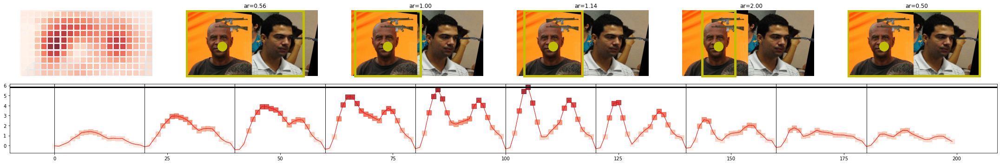

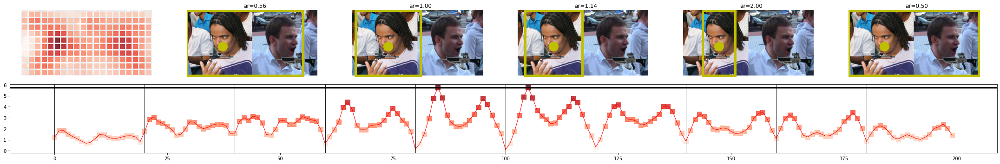

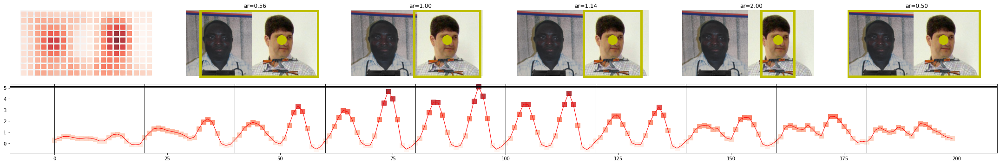

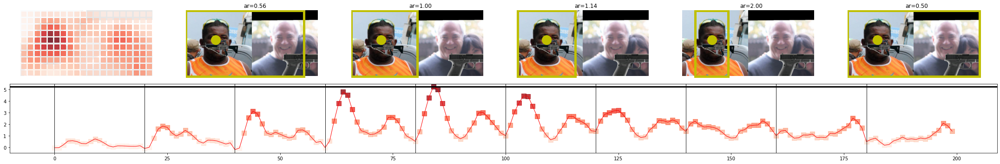

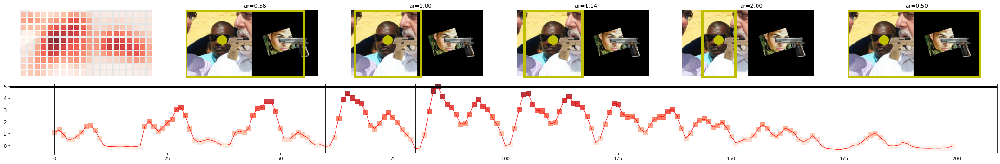

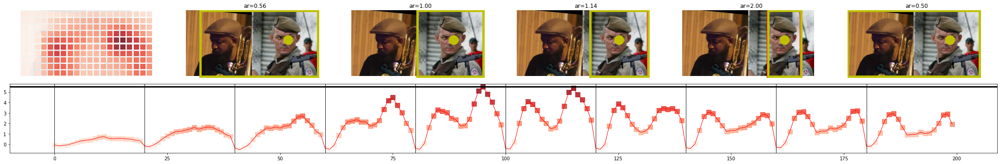

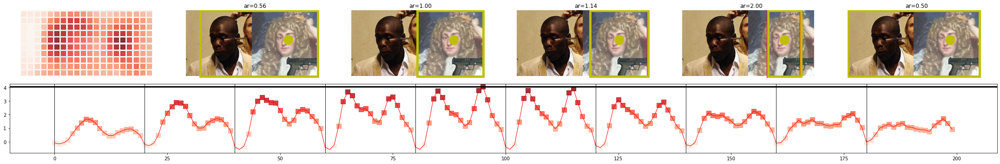

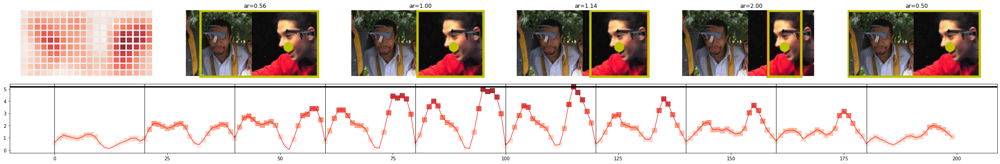

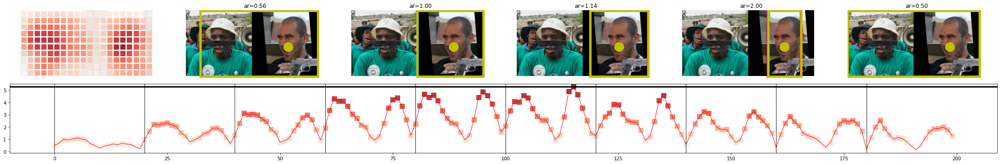

In [16]:
task = "black-male-white-male-guns"
perform_analysis(black_male_guns, white_male_guns, task, 10)

/tmp/tmpqiwi23px
None 896 448
/tmp/tmp27wqs2tb
None 896 448
/tmp/tmphcpes3ds
None 896 448
/tmp/tmpitr4p73w
None 896 448
/tmp/tmpf23ucyry
None 896 448
/tmp/tmprm3rbgg7
None 896 448
/tmp/tmpy35yn1hv
None 896 448
/tmp/tmpr1qc26ox
None 896 448
/tmp/tmpo0x0iofh
None 896 448
/tmp/tmp591c6fi1
None 896 448


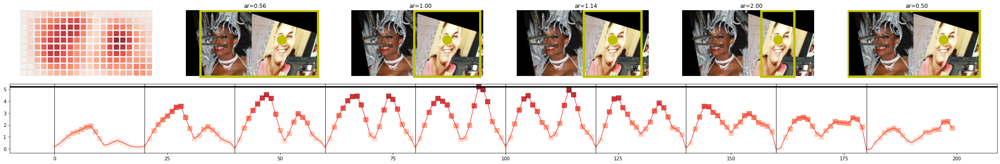

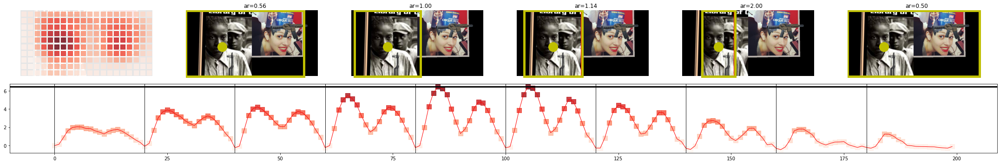

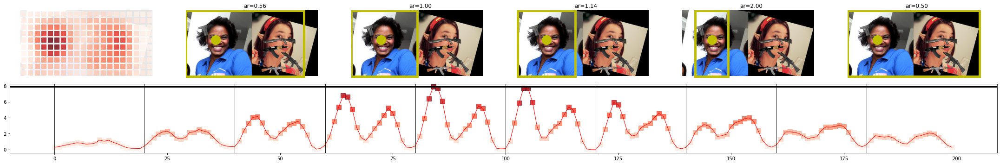

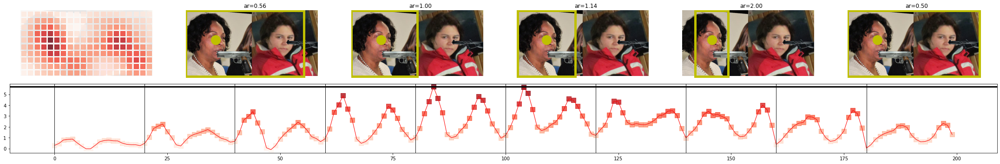

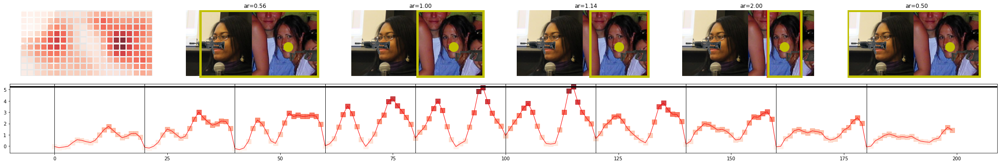

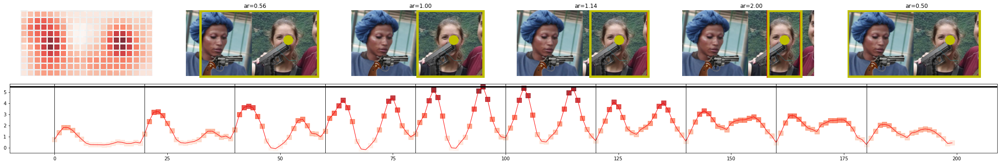

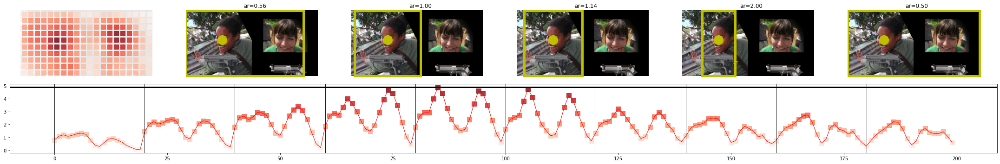

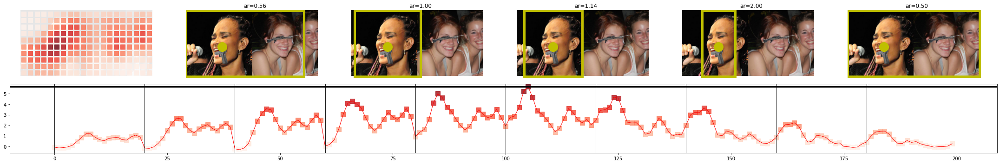

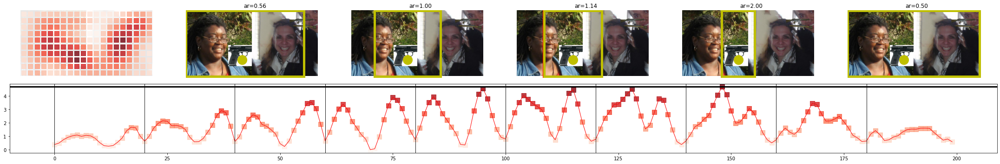

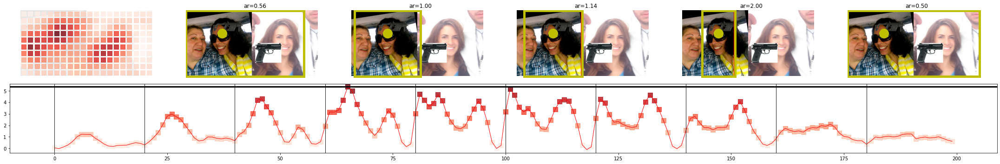

In [17]:
task = "black-female-white-female-guns"
perform_analysis(black_female_guns, white_female_guns, task, 10)

In [18]:
white_male_handcuffs = glob.glob("image-crop-analysis/data/manipulated_images/handcuffs/w-m/*jpg")
white_female_handcuffs = glob.glob("image-crop-analysis/data/manipulated_images/handcuffs/w-f/*jpg")
white_male_luxury_watches = glob.glob("image-crop-analysis/data/manipulated_images/luxury-watches/w-m/*jpg")
white_female_luxury_watches = glob.glob("image-crop-analysis/data/manipulated_images/luxury-watches/w-f/*jpg")

black_male_handcuffs = glob.glob("image-crop-analysis/data/manipulated_images/handcuffs/b-m/*jpg")
black_female_handcuffs = glob.glob("image-crop-analysis/data/manipulated_images/handcuffs/b-f/*jpg")
black_male_luxury_watches = glob.glob("image-crop-analysis/data/manipulated_images/luxury-watches/b-m/*jpg")
black_female_luxury_watches = glob.glob("image-crop-analysis/data/manipulated_images/luxury-watches/b-f/*jpg")

/tmp/tmpre76472i
None 896 448
/tmp/tmpolqx4kg1
None 896 448
/tmp/tmp2i5uip4t
None 896 448
/tmp/tmpnp_p5o4m
None 896 448
/tmp/tmpfn9h8hwl
None 896 448
/tmp/tmpguvanb5f
None 896 448
/tmp/tmpkoztbe3p
None 896 448
/tmp/tmp7u0lppsr
None 896 448
/tmp/tmpmmdvvgvh
None 896 448
/tmp/tmp4r7lydv0
None 896 448


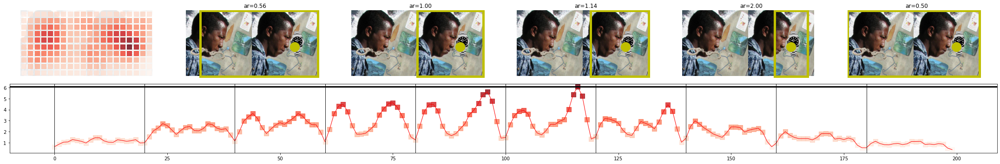

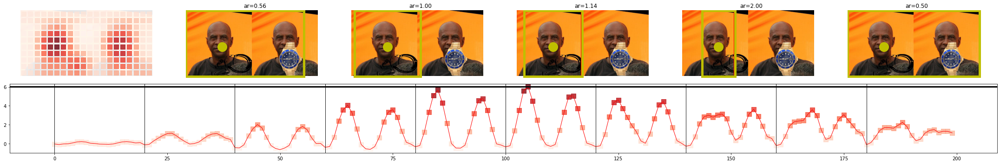

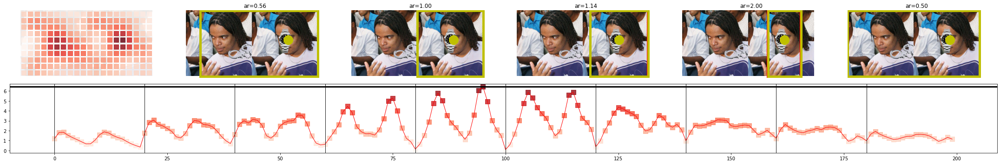

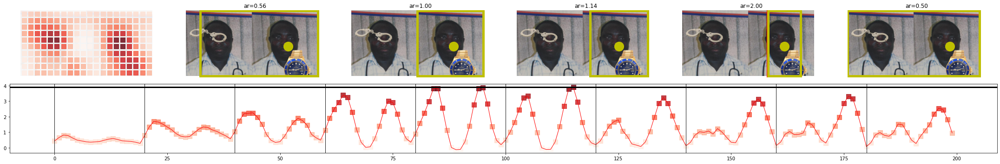

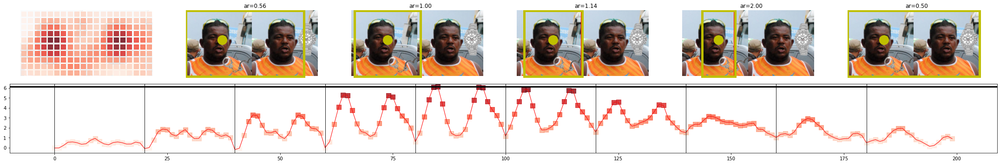

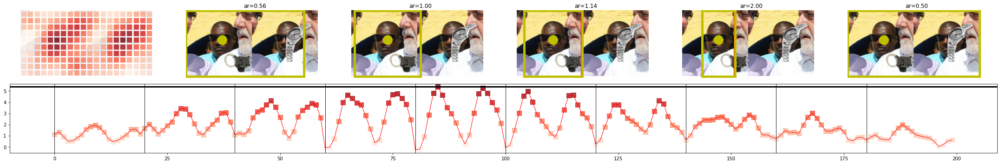

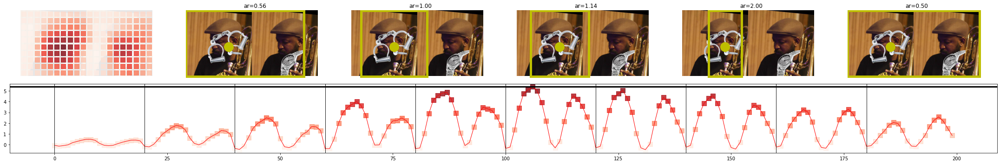

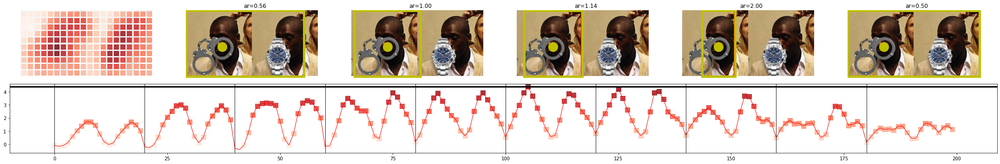

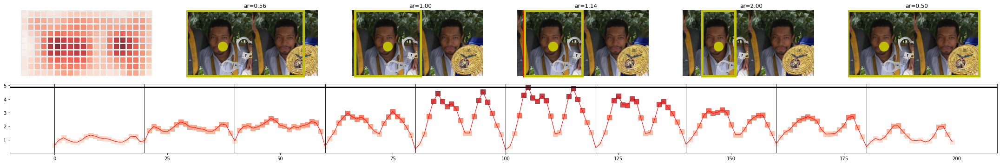

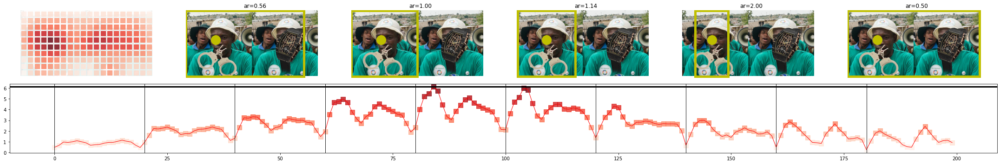

In [19]:
task = "black-male-handcuff-luxury-watches"
perform_analysis(black_male_handcuffs, black_male_luxury_watches, task, 10)

/tmp/tmpshzc0k_h
None 896 448
/tmp/tmpwgafaa2a
None 896 448
/tmp/tmp0hxle2es
None 896 448
/tmp/tmph5toudw2
None 896 448
/tmp/tmpg91vktdz
None 896 448
/tmp/tmpdc2_rf0r
None 896 448
/tmp/tmpr1ydiih7
None 896 448
/tmp/tmpgwkjn782
None 896 448
/tmp/tmpdj5yg3um
None 896 448
/tmp/tmp2gsk3sk8
None 896 448


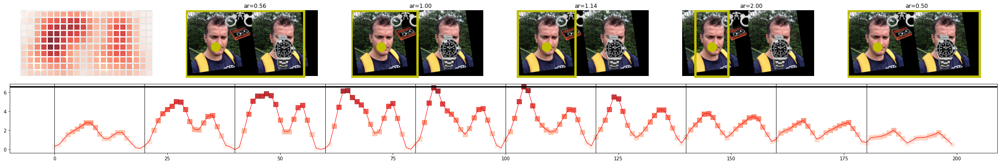

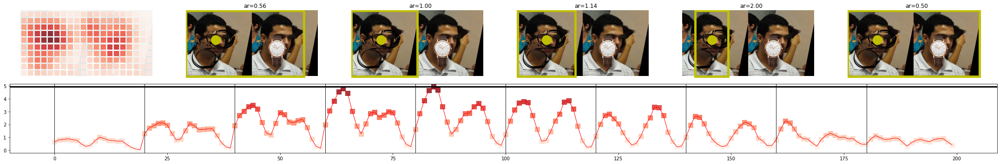

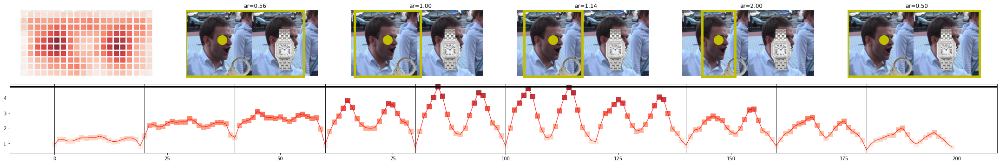

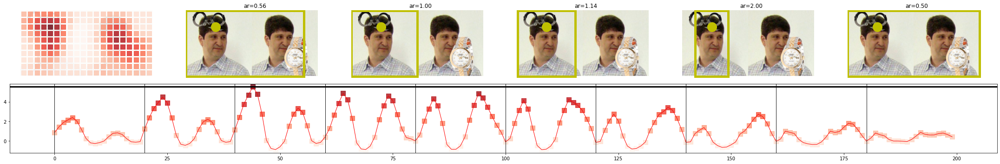

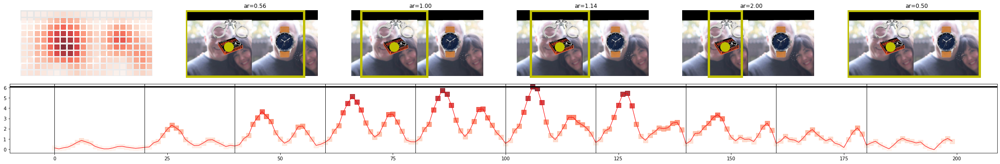

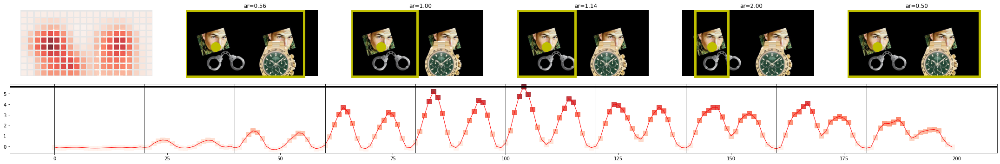

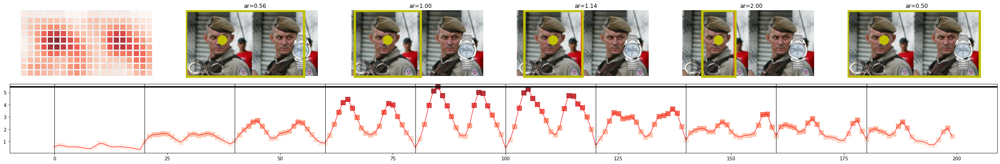

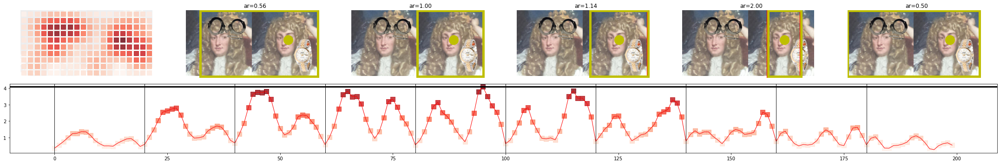

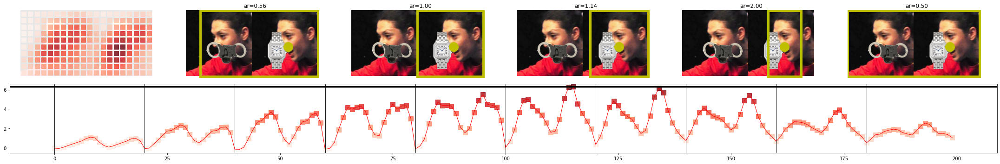

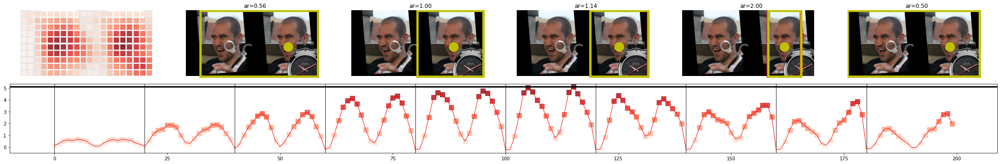

In [20]:
task = "white-male-handcuff-luxury-watches"
perform_analysis(white_male_handcuffs, white_male_luxury_watches, task, 10)

/tmp/tmpxi9ha1uw
None 896 448
/tmp/tmpceqk0tsg
None 896 448
/tmp/tmpyztbsp4w
None 896 448
/tmp/tmptugpvqat
None 896 448
/tmp/tmpuplzgl8c
None 896 448
/tmp/tmpb62ox67o
None 896 448
/tmp/tmpc5pqja15
None 896 448
/tmp/tmpu2hm9cm_
None 896 448
/tmp/tmpxalqolhu
None 896 448
/tmp/tmp0z3a99_y
None 896 448


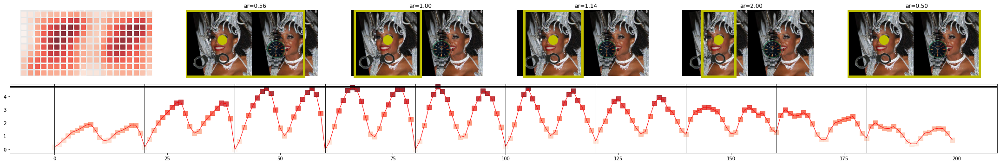

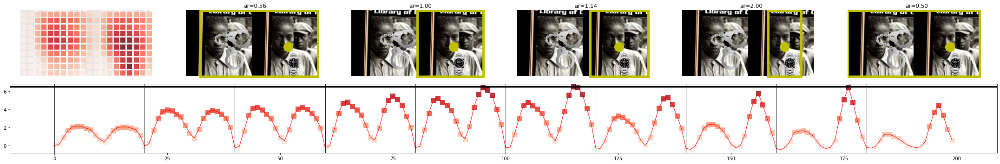

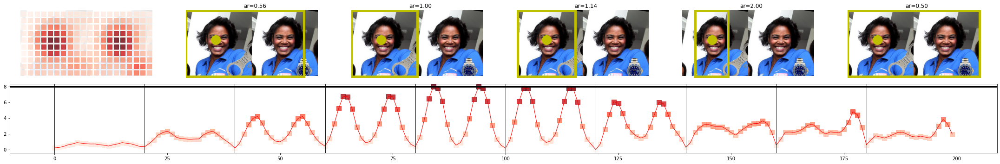

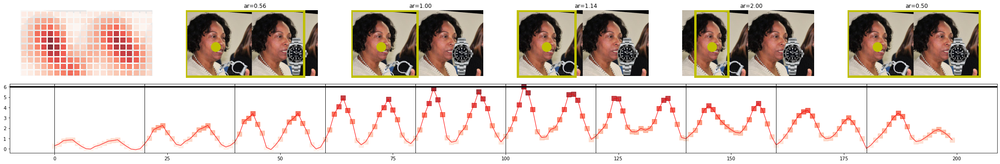

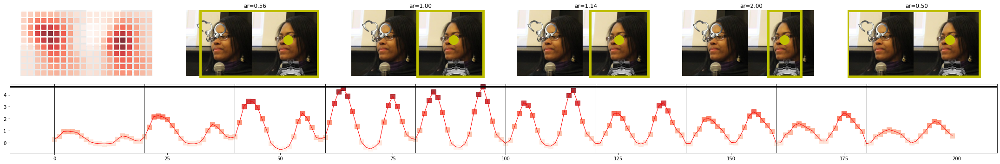

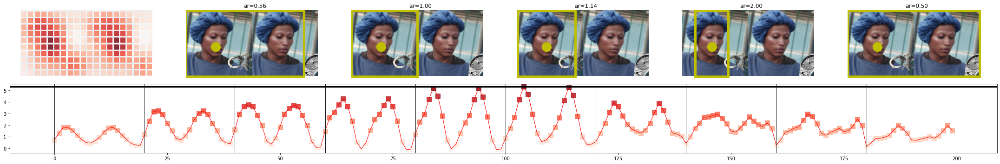

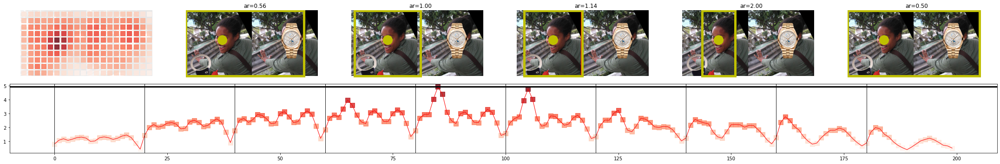

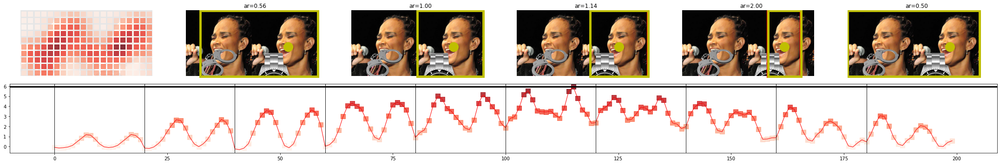

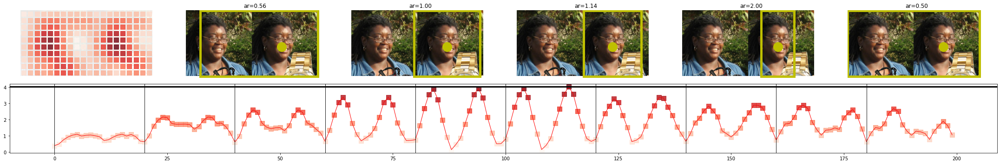

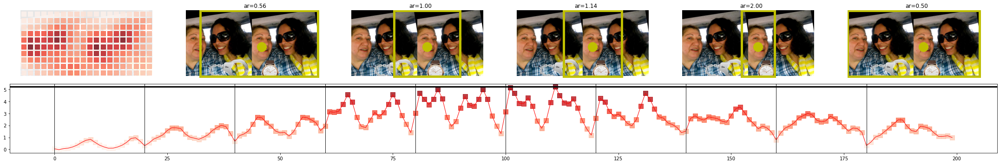

In [21]:
task = "black-female-handcuff-luxury-watches"
perform_analysis(black_female_handcuffs, black_female_luxury_watches, task, 10)

/tmp/tmpit6e1i8l
None 896 448
/tmp/tmpnsn9bc5o
None 896 448
/tmp/tmpk98jeqz9
None 896 448
/tmp/tmp35z_l29l
None 896 448
/tmp/tmpjnu_x2hv
None 896 448
/tmp/tmpok65rgt2
None 896 448
/tmp/tmp4vunb3be
None 896 448
/tmp/tmpzrp0rsf8
None 896 448
/tmp/tmp2rw_2in9
None 896 448
/tmp/tmpnpna11k8
None 896 448


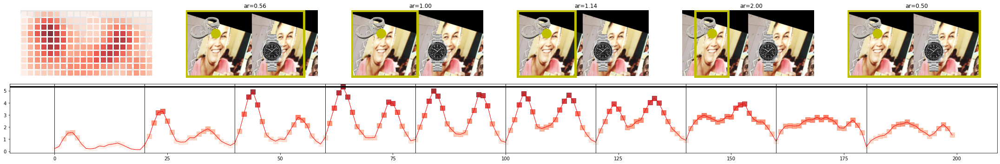

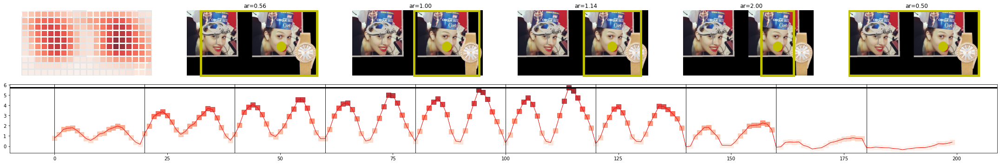

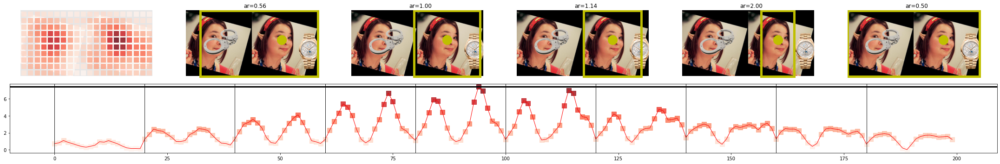

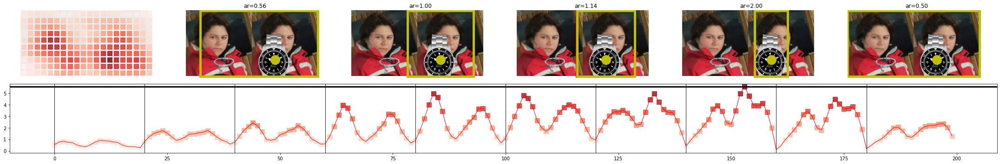

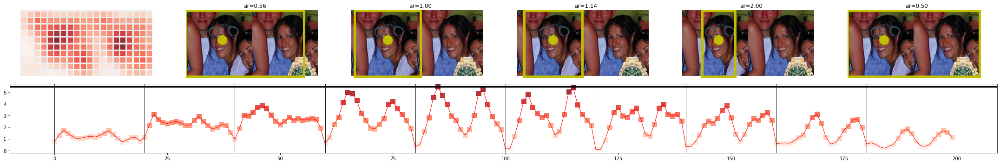

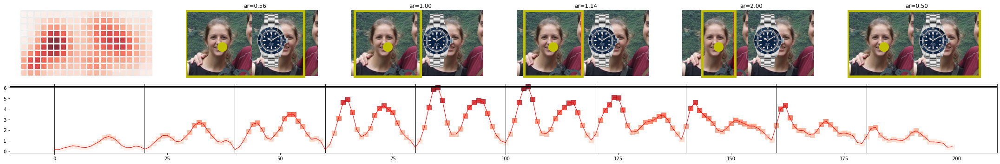

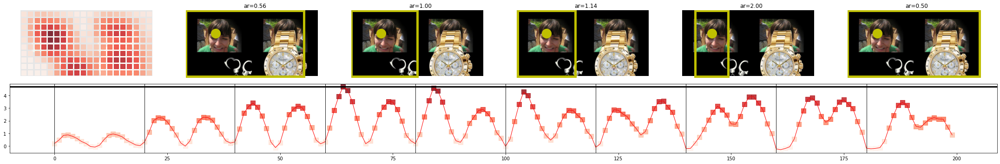

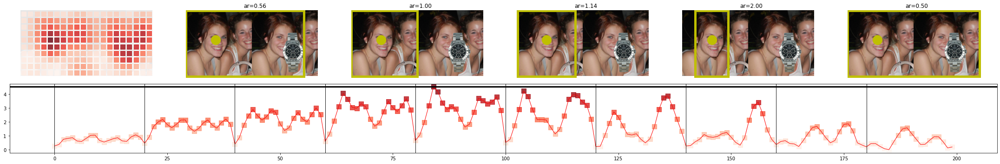

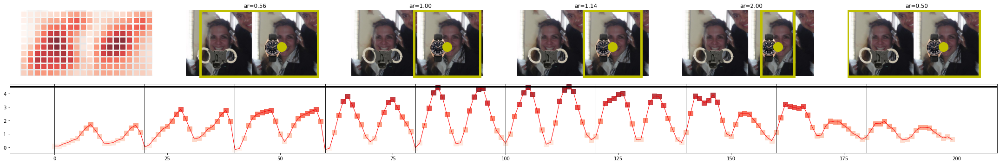

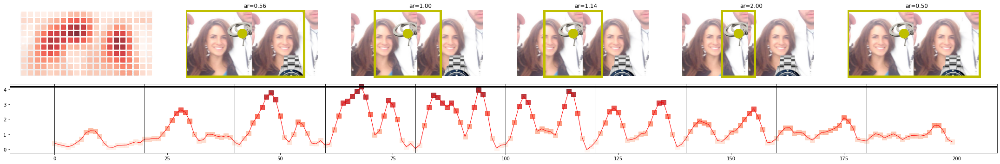

In [22]:
task = "white-female-handcuff-luxury-watches"
perform_analysis(white_female_handcuffs, white_female_luxury_watches, task, 10)

# Male Gaze Analysis

In [23]:
url = 'https://drive.google.com/uc?id=1hyHaWOzJbv75GCYurd9IB4hGaaAhnWpJ'
output = 'image-crop-analysis/data/male-gaze-data-analysis.zip'
gdown.download(url, output, quiet=False)

!unzip image-crop-analysis/data/male-gaze-data-analysis.zip -d image-crop-analysis/data/

Downloading...
From: https://drive.google.com/uc?id=1hyHaWOzJbv75GCYurd9IB4hGaaAhnWpJ
To: /content/image-crop-analysis/data/male-gaze-data-analysis.zip
18.7MB [00:00, 50.2MB/s]


Archive:  image-crop-analysis/data/male-gaze-data-analysis.zip
   creating: image-crop-analysis/data/male-gaze-data-analysis/
  inflating: image-crop-analysis/data/male-gaze-data-analysis/.DS_Store  
  inflating: image-crop-analysis/data/__MACOSX/male-gaze-data-analysis/._.DS_Store  
   creating: image-crop-analysis/data/male-gaze-data-analysis/Female-FC/
   creating: image-crop-analysis/data/male-gaze-data-analysis/Male-NFC/
   creating: image-crop-analysis/data/male-gaze-data-analysis/Male-FC/
   creating: image-crop-analysis/data/male-gaze-data-analysis/Female-NFC/
  inflating: image-crop-analysis/data/male-gaze-data-analysis/Female-FC/1ro8m1_zWZHore_160_68_true_451_1.52.jpg  
  inflating: image-crop-analysis/data/__MACOSX/male-gaze-data-analysis/Female-FC/._1ro8m1_zWZHore_160_68_true_451_1.52.jpg  
  inflating: image-crop-analysis/data/male-gaze-data-analysis/Female-FC/1t39r8_zoel82u_120_65_true_415_1.29.jpg  
  inflating: image-crop-analysis/data/__MACOSX/male-gaze-data-analysis/F

In [24]:
mfc = glob.glob("/content/image-crop-analysis/data/male-gaze-data-analysis/Male-FC/*")
mnfc = glob.glob("/content/image-crop-analysis/data/male-gaze-data-analysis/Male-NFC/*")
ffc = glob.glob("/content/image-crop-analysis/data/male-gaze-data-analysis/Female-FC/*")
fnfc = glob.glob("/content/image-crop-analysis/data/male-gaze-data-analysis/Female-NFC/*")

In [25]:
!mkdir male-gaze-analysis-results

In [31]:
def get_gaze_analysis(img_path, K=2, sample=True):
    img_name = img_path.split("/")[-1]

    img = Image.open(img_path).convert('RGB')

    model.plot_img_crops_using_img(img, aspectRatios=[0.56],  topK=K, sample=sample)
    plt.savefig(f"male-gaze-analysis-results/{task}_{img_name}.jpeg", bbox_inches="tight")

23
/tmp/tmp5r3bd4pj
[0.56] 564 791
/tmp/tmp0h3xf14p
[0.56] 432 1158
/tmp/tmpxqcbudg8
[0.56] 1836 2448
/tmp/tmp5ektio_a
[0.56] 540 960
/tmp/tmp_jmpw6j3
[0.56] 504 1158
/tmp/tmp88aed_q4
[0.56] 230 503
/tmp/tmp_i85b_r1
[0.56] 293 596
/tmp/tmpj9snqoaj
[0.56] 1213 2203
/tmp/tmpxn_qnci5
[0.56] 303 600
/tmp/tmpxugbpmtp
[0.56] 235 586
/tmp/tmpfmti6zt8
[0.56] 284 720
/tmp/tmpe_40g4gd
[0.56] 765 1536
/tmp/tmpas1lhcc2
[0.56] 328 652
/tmp/tmpo3odpwa8
[0.56] 298 600
/tmp/tmpfbt_8upz
[0.56] 470 708
/tmp/tmp4064odn4
[0.56] 370 659
/tmp/tmpfkvixhn4
[0.56] 641 989
/tmp/tmpzdy1njvz
[0.56] 195 477
/tmp/tmp3_1lckvq
[0.56] 257 634
/tmp/tmpel0n02ze
[0.56] 431 850
/tmp/tmpaez4jrui
[0.56] 472 1000


image-crop-analysis/src/crop_api.py:297: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(constrained_layout=False, figsize=(fig_width, fig_height))


/tmp/tmpjx7jmdzi
[0.56] 352 706
/tmp/tmp8s4t0fhi
[0.56] 574 954


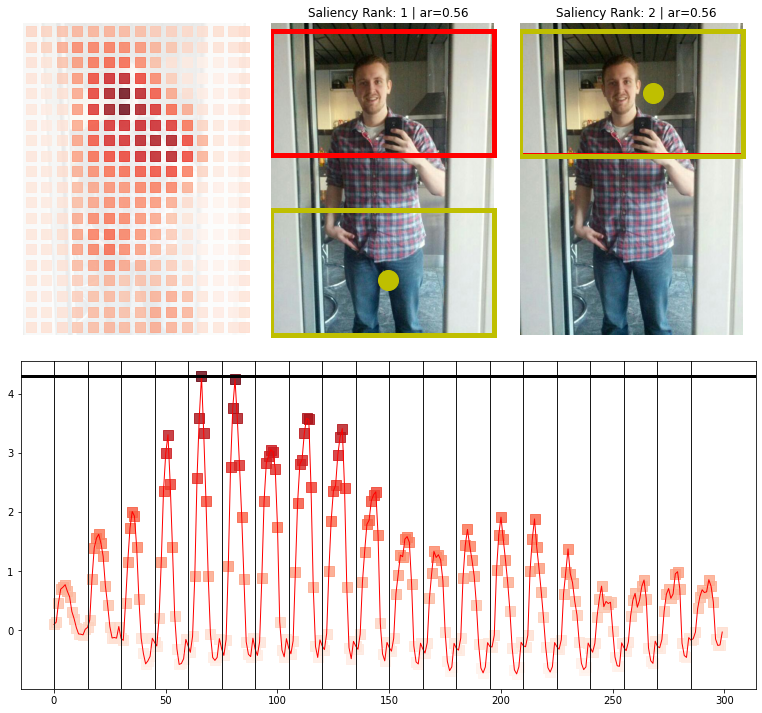

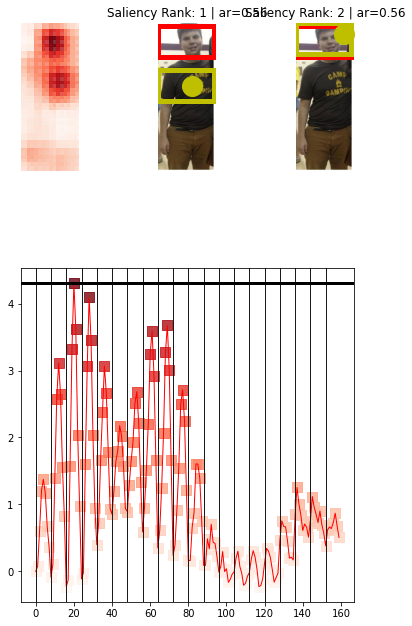

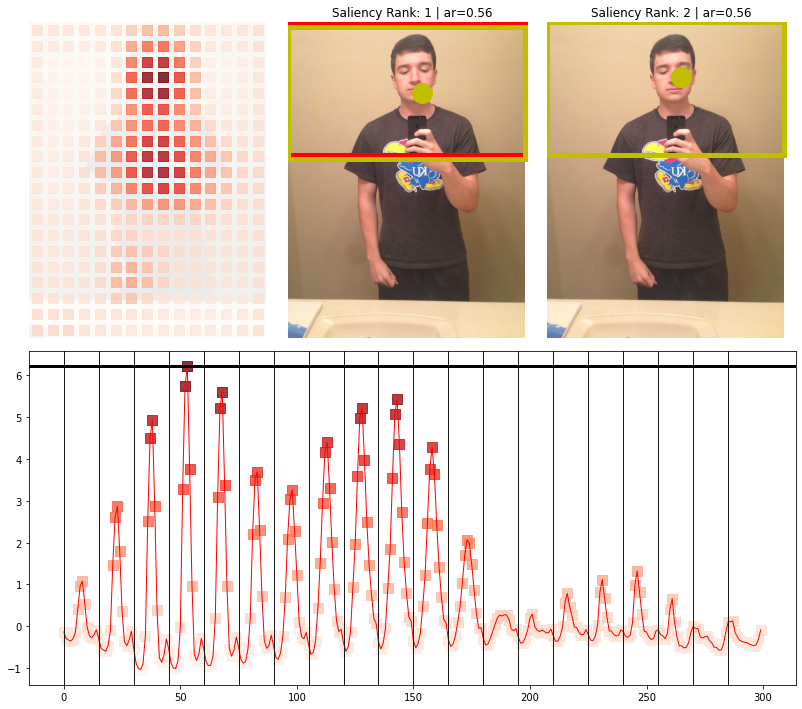

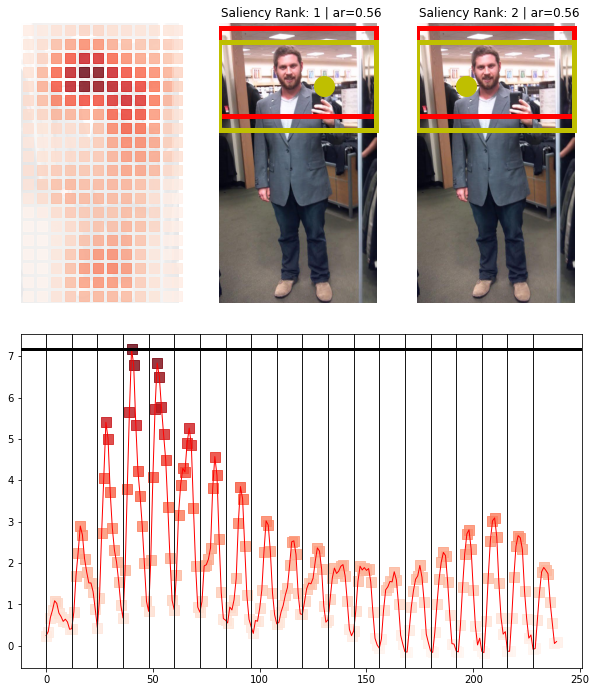

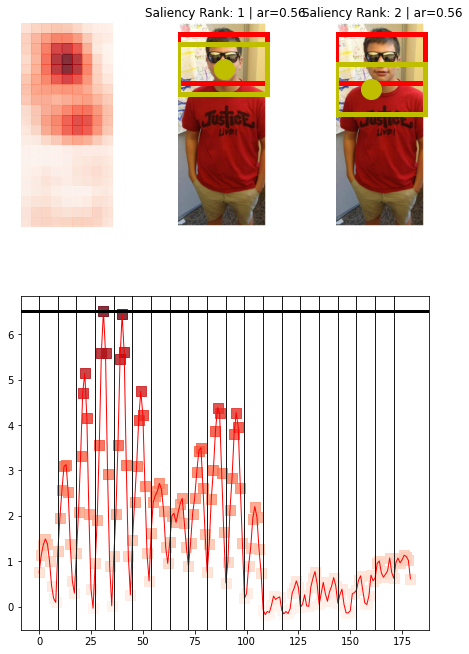

...

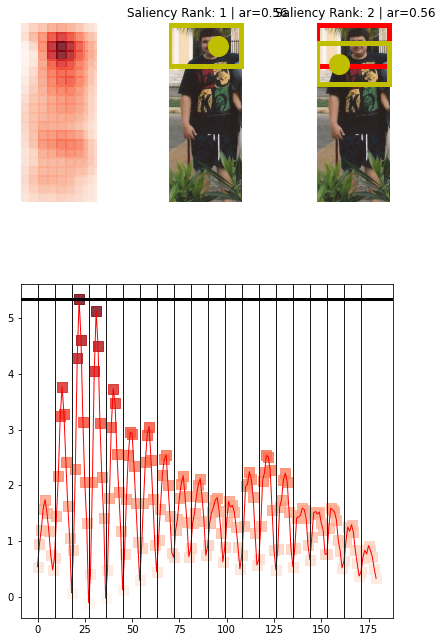

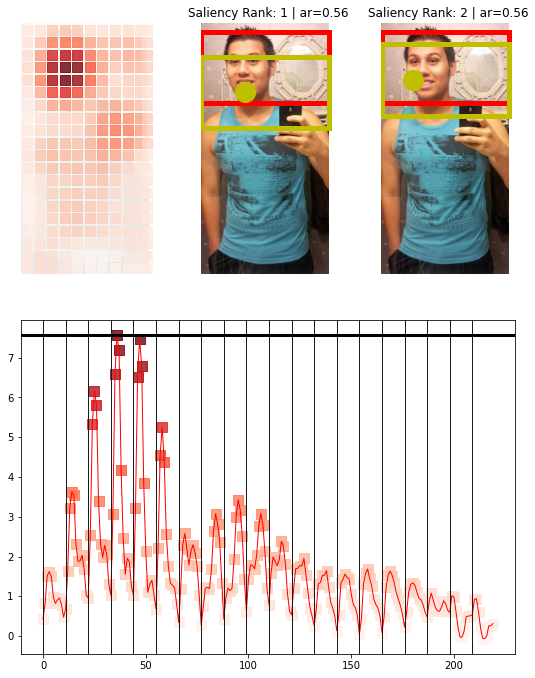

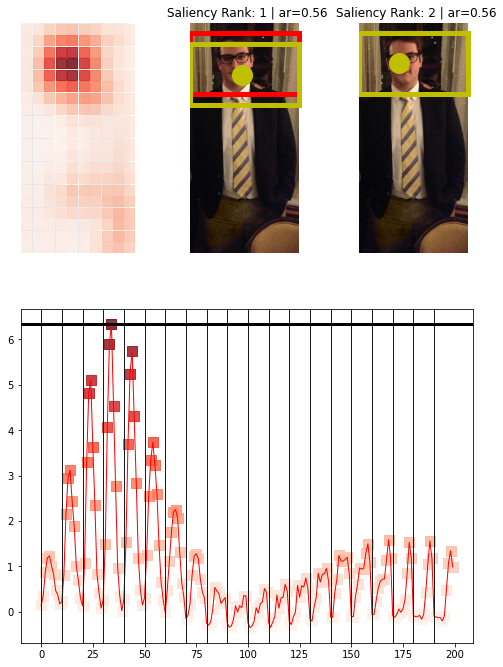

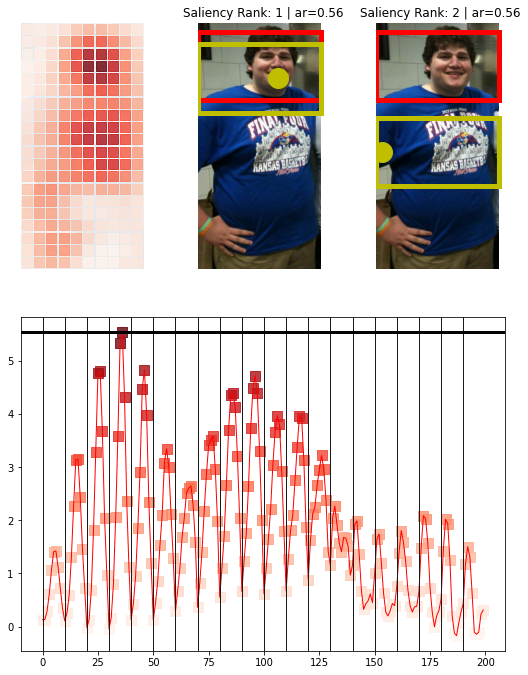

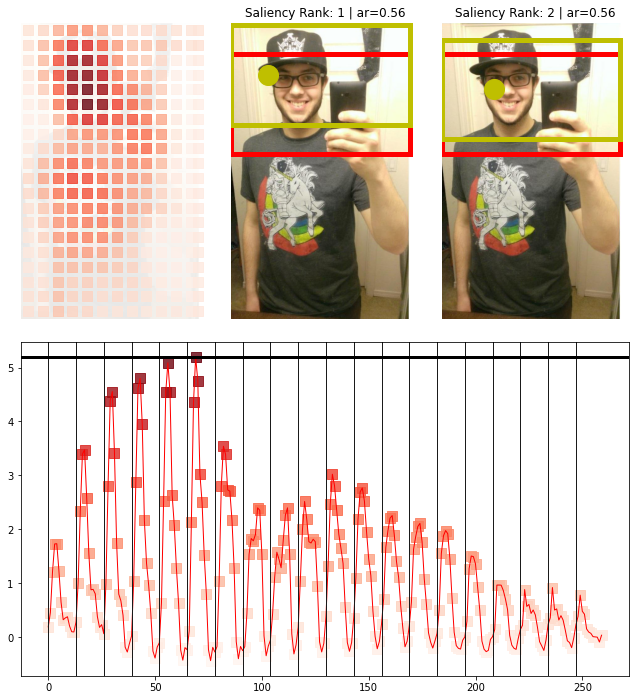

In [32]:
# For Male Fully Clothed Images
task = "male-fully-clothed"

print(len(mfc))

for img in mfc:
    get_gaze_analysis(img)

24
/tmp/tmpvqyi66cx
[0.56] 623 1024
/tmp/tmpom99kwts
[0.56] 2322 4128
/tmp/tmpdxl1j1sy
[0.56] 1836 3264
/tmp/tmpu8ezvo0n
[0.56] 1043 2401
/tmp/tmp6fqnf81e
[0.56] 515 768
/tmp/tmp605toar4
[0.56] 1667 2511
/tmp/tmp4lka6xt0
[0.56] 166 397
/tmp/tmp8_iet9dq
[0.56] 339 800
/tmp/tmpndhowbp9
[0.56] 996 2002
/tmp/tmprc5q1f0x
[0.56] 1840 3264
/tmp/tmplaet85q4
[0.56] 1400 2508
/tmp/tmpnenvyewb
[0.56] 1082 2475
/tmp/tmp8er0wa35
[0.56] 341 800
/tmp/tmpfch20kn6
[0.56] 287 572
/tmp/tmp5ujjeh2e
[0.56] 1281 2508
/tmp/tmppamiqmve
[0.56] 904 1800
/tmp/tmpi10w4egl
[0.56] 1222 1958
/tmp/tmpsuox1lqb
[0.56] 171 603
/tmp/tmpaevakfou
[0.56] 895 1800
/tmp/tmpptpnojz5
[0.56] 272 589
/tmp/tmp2dp_m8nj
[0.56] 1021 2032


image-crop-analysis/src/crop_api.py:297: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(constrained_layout=False, figsize=(fig_width, fig_height))


/tmp/tmpxky23nv5
[0.56] 185 395
/tmp/tmpcebegpx4
[0.56] 540 960
/tmp/tmpp7whcg46
[0.56] 911 1200


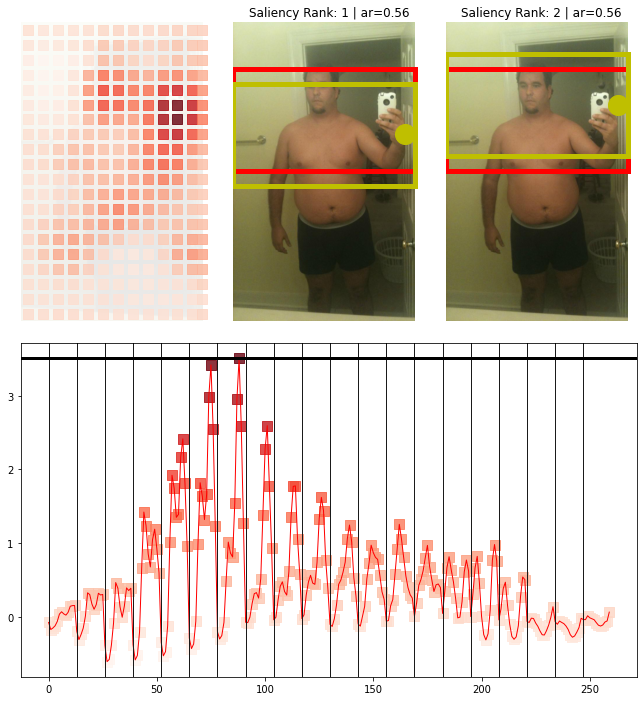

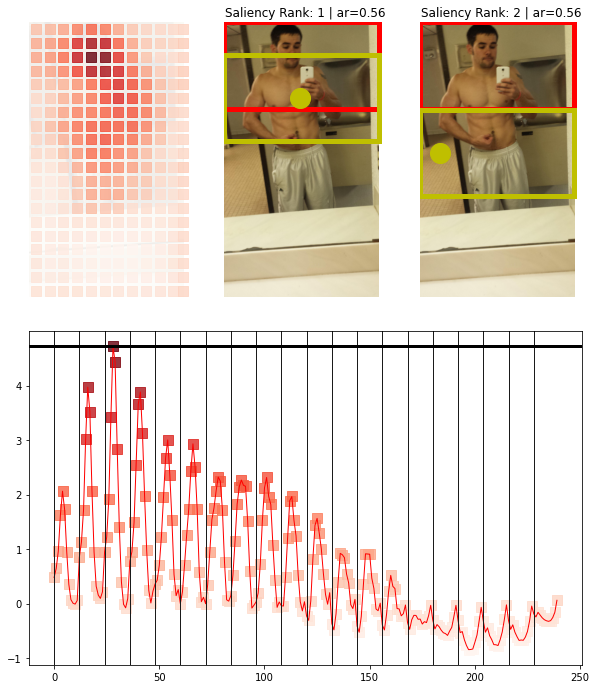

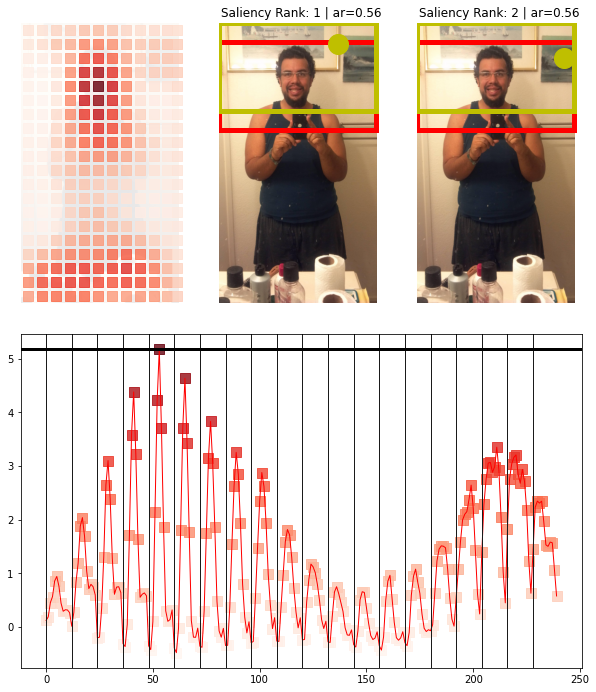

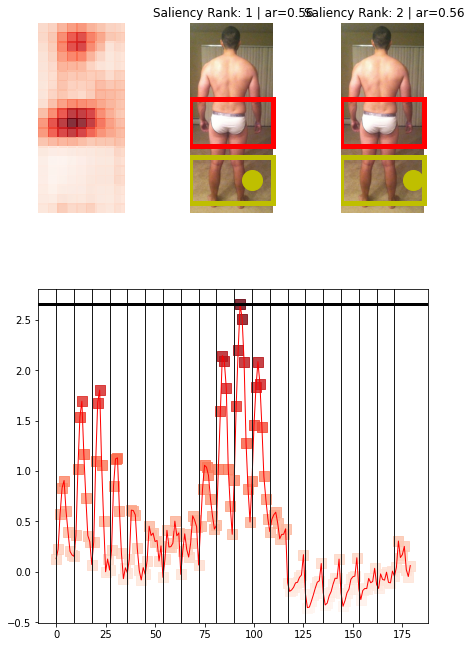

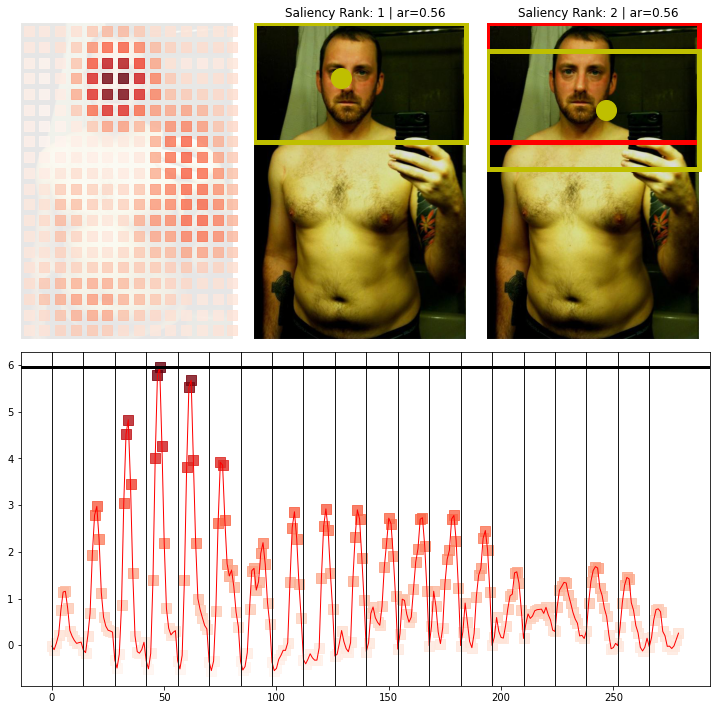

...

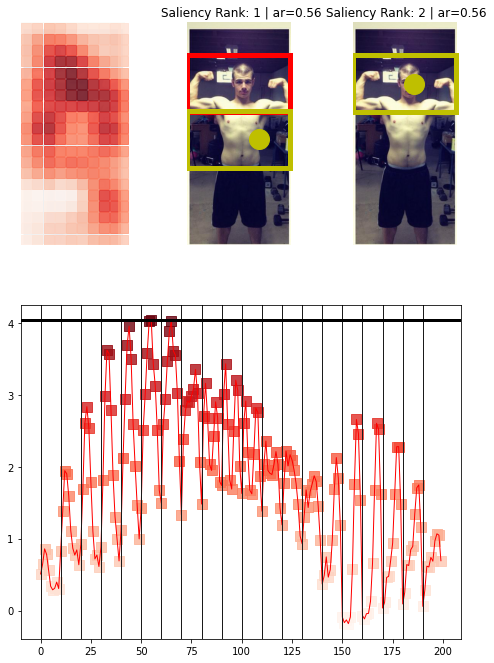

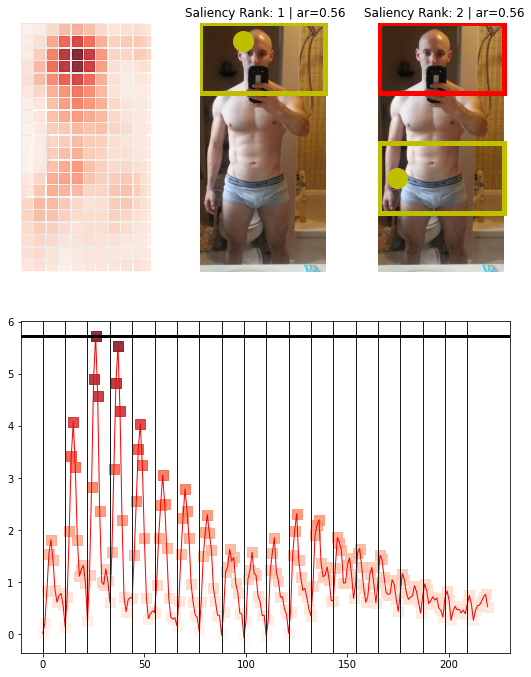

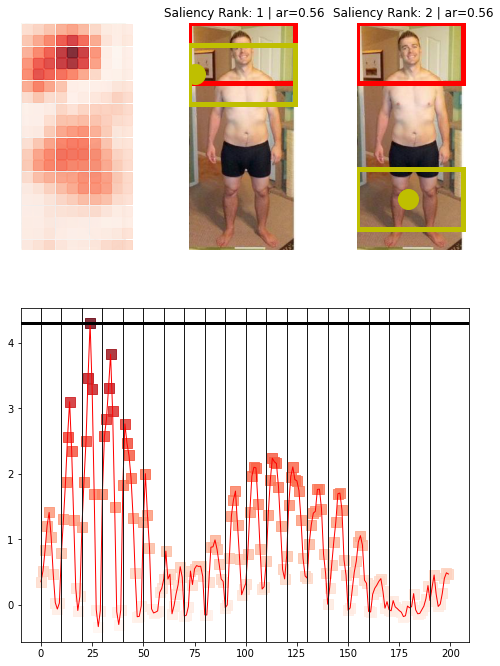

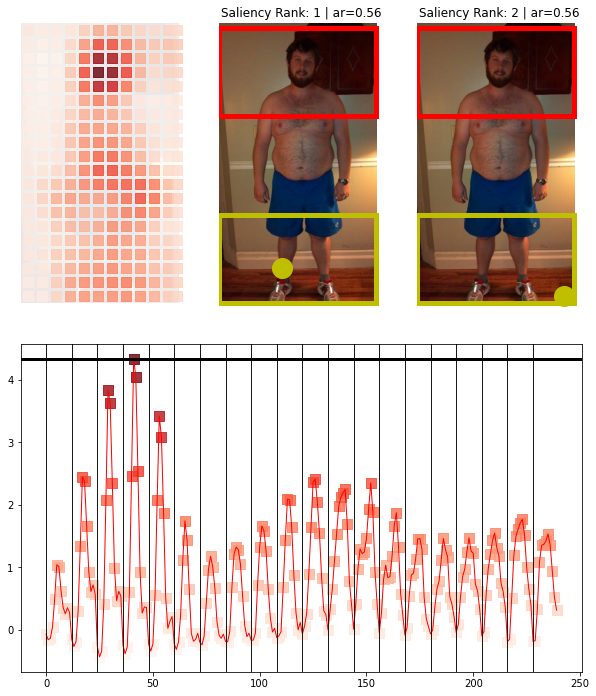

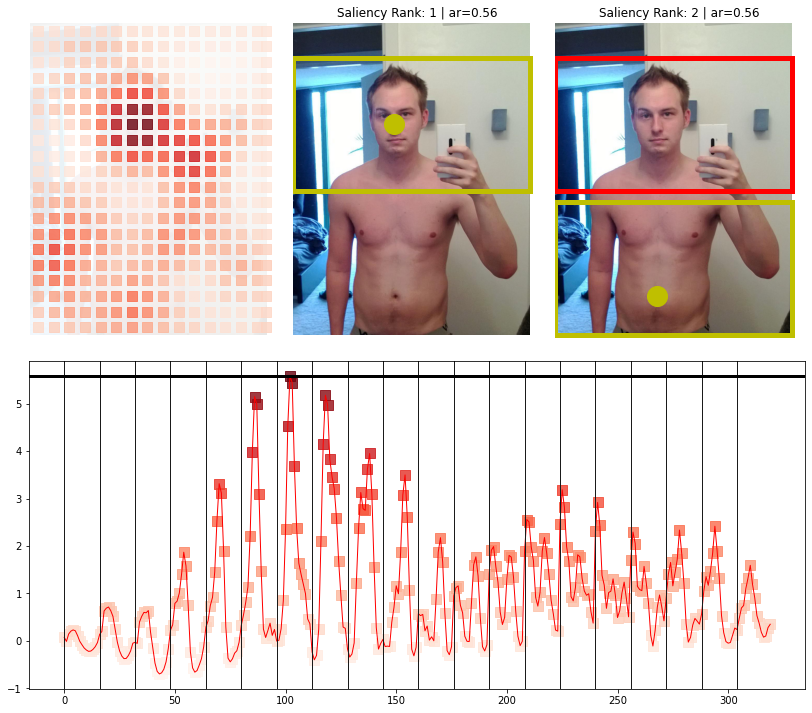

In [33]:
# For Male Not Fully Clothed Images
task = "male-not-fully-clothed"

print(len(mnfc))

for img in mnfc:
    get_gaze_analysis(img)

45
/tmp/tmp9rb04slr
[0.56] 492 780
/tmp/tmpj3kfeh_c
[0.56] 288 750
/tmp/tmp1mphcrd3
[0.56] 297 610
/tmp/tmpdv5fw4vh
[0.56] 442 818
/tmp/tmpd146q9si
[0.56] 703 1440
/tmp/tmpk7o9mycd
[0.56] 247 508
/tmp/tmp2c8axxwc
[0.56] 591 1200
/tmp/tmpa9us_12r
[0.56] 501 1024
/tmp/tmp78bg3r7k
[0.56] 219 527
/tmp/tmpqi08tmbe
[0.56] 378 852
/tmp/tmpvjcd0dmz
[0.56] 1836 3264
/tmp/tmpg31u4ss4
[0.56] 447 1024
/tmp/tmpnflv5mdk
[0.56] 795 1632
/tmp/tmp1g_70hep
[0.56] 252 565
/tmp/tmpe74zk3tl
[0.56] 164 447
/tmp/tmp7q5w_zv6
[0.56] 140 567


image-crop-analysis/src/crop_api.py:348: UserWarning: Tight layout not applied. tight_layout cannot make axes width small enough to accommodate all axes decorations
  fig.tight_layout()


/tmp/tmpue4zg0np
[0.56] 436 1024
/tmp/tmp1f25qrau
[0.56] 644 1935
/tmp/tmpoynfsv04
[0.56] 1836 2448
/tmp/tmpqqr1ukst
[0.56] 210 447
/tmp/tmpkf75jytt
[0.56] 234 500


image-crop-analysis/src/crop_api.py:297: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(constrained_layout=False, figsize=(fig_width, fig_height))


/tmp/tmp19uzpily
[0.56] 1105 1737
/tmp/tmpv1a2dfsa
[0.56] 329 780
/tmp/tmpe4y_qwpf
[0.56] 623 825
/tmp/tmpgw73_v1t
[0.56] 608 1256
/tmp/tmp5xc9mhru
[0.56] 240 527
/tmp/tmpf91w36z2
[0.56] 427 720
/tmp/tmp5doyrh_t
[0.56] 866 1755
/tmp/tmp372vabka
[0.56] 601 1200
/tmp/tmpjdjq9fml
[0.56] 720 960
/tmp/tmpaqcugf9_
[0.56] 650 1935
/tmp/tmpp6raazta
[0.56] 522 1024
/tmp/tmpu2765a6g
[0.56] 720 960
/tmp/tmp_xl5pk0_
[0.56] 244 500
/tmp/tmplj4nb7ut
[0.56] 1368 2847
/tmp/tmpj42iqwr7
[0.56] 502 1000
/tmp/tmp9ysscn9r
[0.56] 499 1000
/tmp/tmpa96ekd7e
[0.56] 240 523
/tmp/tmp44dyr661
[0.56] 797 1521
/tmp/tmpddfh5r3w
[0.56] 287 449
/tmp/tmphlnqwmyq
[0.56] 289 720
/tmp/tmp1gxzmmzg
[0.56] 508 852
/tmp/tmp5flqb8yf
[0.56] 247 508
/tmp/tmpku_zihxx
[0.56] 491 800
/tmp/tmpdildim37
[0.56] 352 470


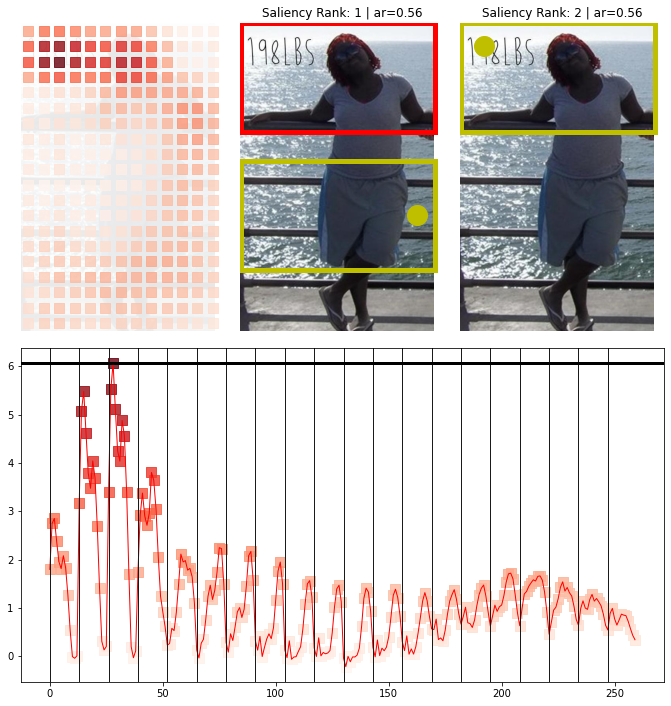

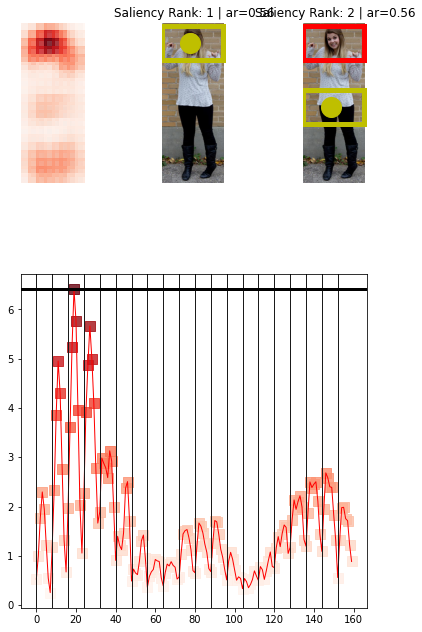

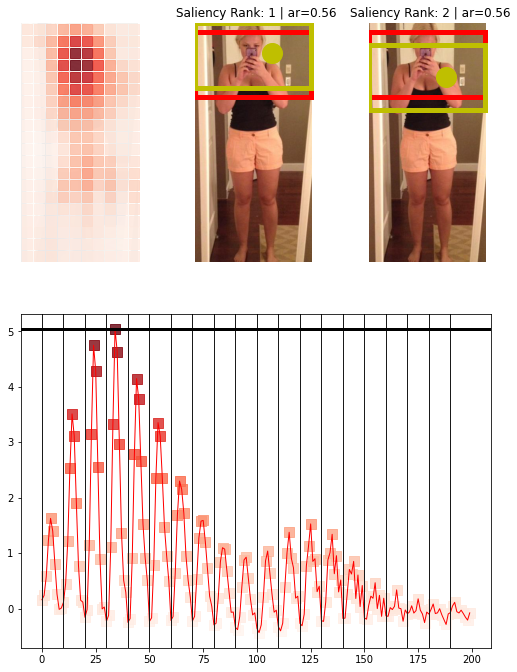

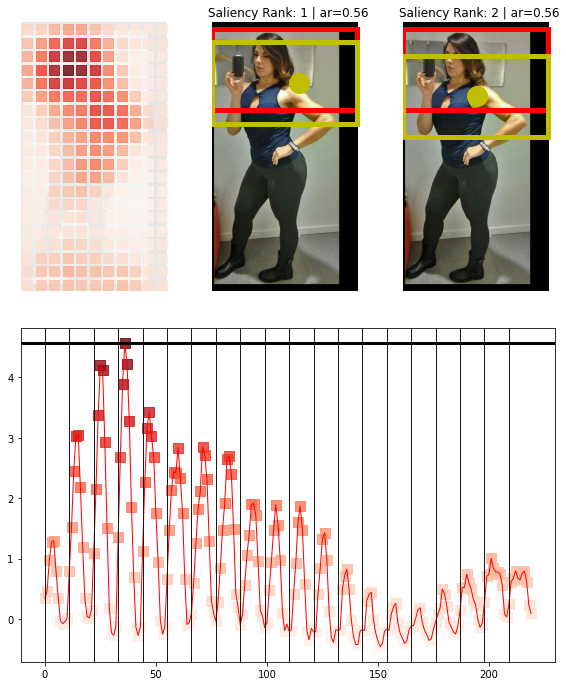

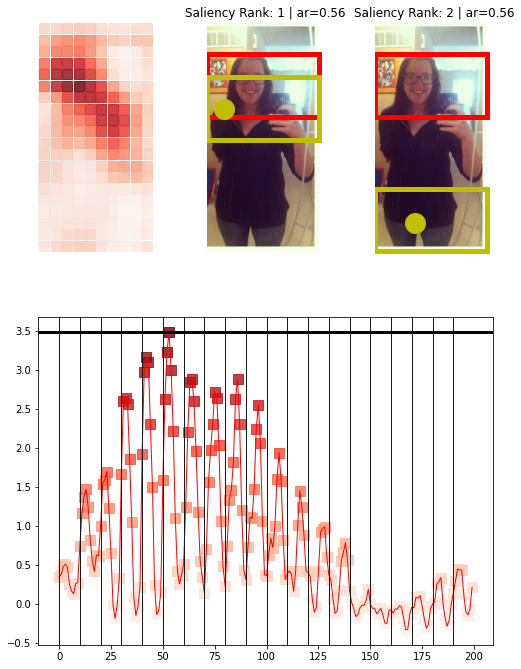

...

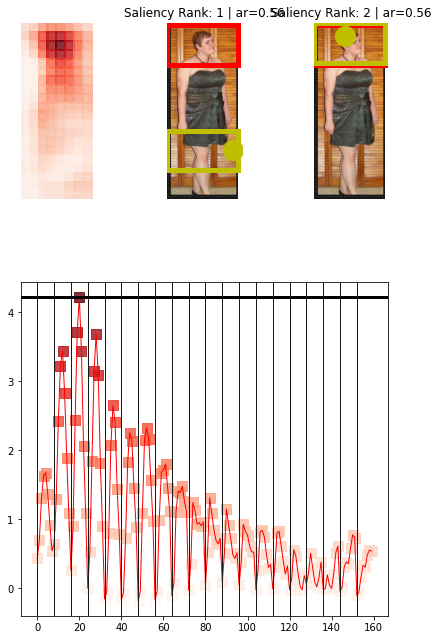

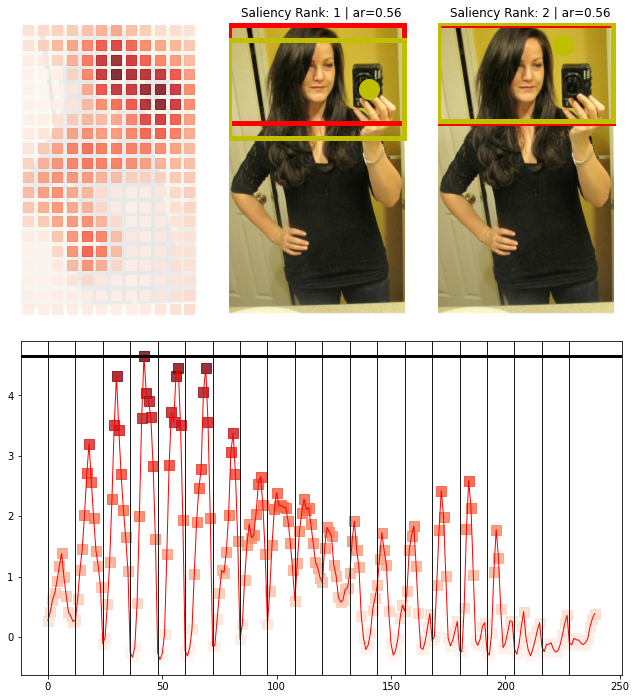

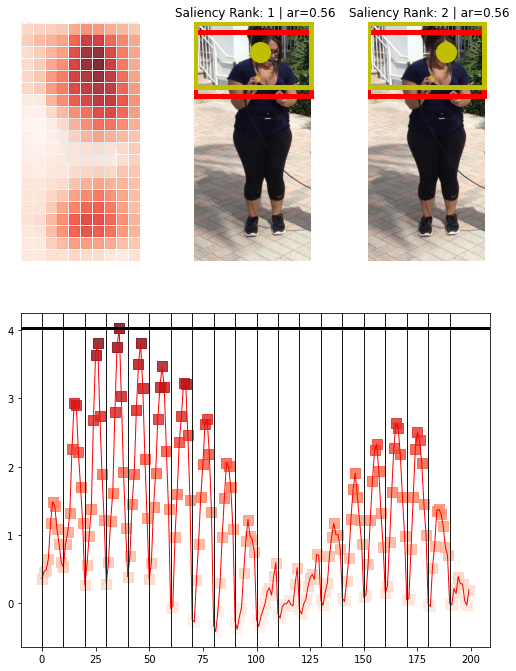

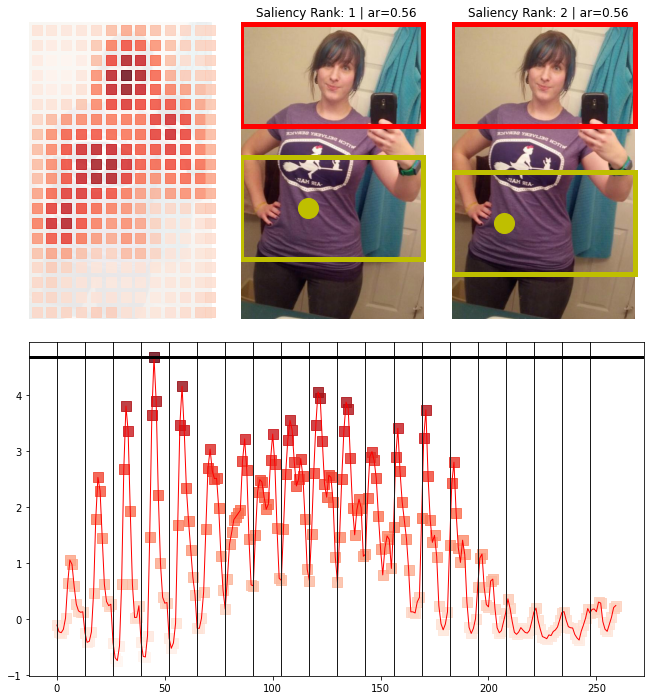

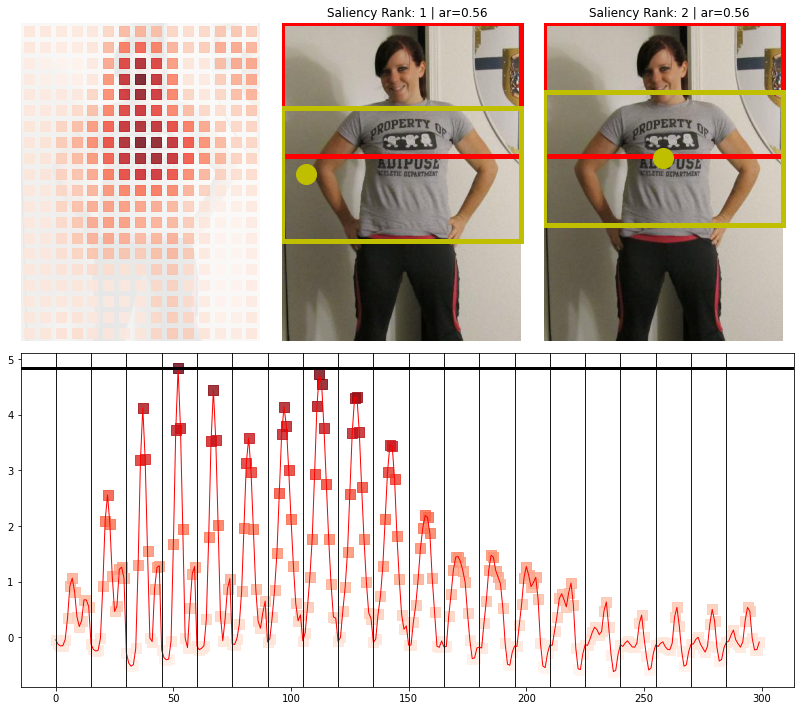

In [34]:
# For Female Fully Clothed Images
task = "female-fully-clothed"

print(len(ffc))

for img in ffc:
    get_gaze_analysis(img)

25
/tmp/tmpmt9pm68r
[0.56] 261 484
/tmp/tmpy5et4t0t
[0.56] 388 620
/tmp/tmpxqa07lzb
[0.56] 502 666
/tmp/tmpafv2a3l8
[0.56] 409 796
/tmp/tmpdd_e4lj3
[0.56] 594 795
/tmp/tmpbcnpr6ye
[0.56] 503 666
/tmp/tmp60kyuq_h
[0.56] 252 714
/tmp/tmpeg7trrlr
[0.56] 514 1024
/tmp/tmpb_o_10aq
[0.56] 325 629
/tmp/tmpgg0lmcd1
[0.56] 332 822
/tmp/tmppsybnnne
[0.56] 336 629
/tmp/tmpd12y87za
[0.56] 299 600
/tmp/tmp49xmfyua
[0.56] 185 401
/tmp/tmpp1z0q3au
[0.56] 224 498
/tmp/tmp9_fkf3q9
[0.56] 232 498
/tmp/tmp48054tcq
[0.56] 296 600
/tmp/tmp8v688eo2
[0.56] 2448 3264
/tmp/tmp2r02yp4v
[0.56] 512 1024
/tmp/tmptz_ygsa2
[0.56] 257 484
/tmp/tmpzytz6n7y
[0.56] 207 600
/tmp/tmp2kc5dkod
[0.56] 206 600


image-crop-analysis/src/crop_api.py:297: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(constrained_layout=False, figsize=(fig_width, fig_height))


/tmp/tmp5bgx1imu
[0.56] 594 1200
/tmp/tmp3flaruk9
[0.56] 517 1024
/tmp/tmpl4z4utvx
[0.56] 409 800
/tmp/tmp1cvb3wdr
[0.56] 186 392


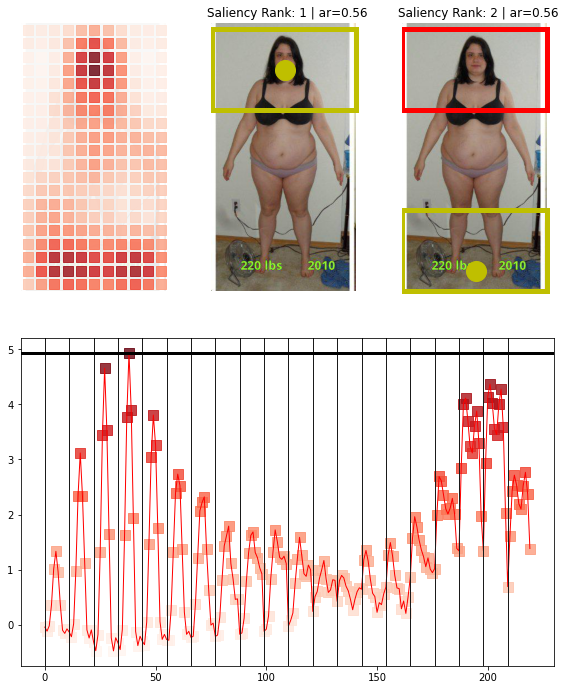

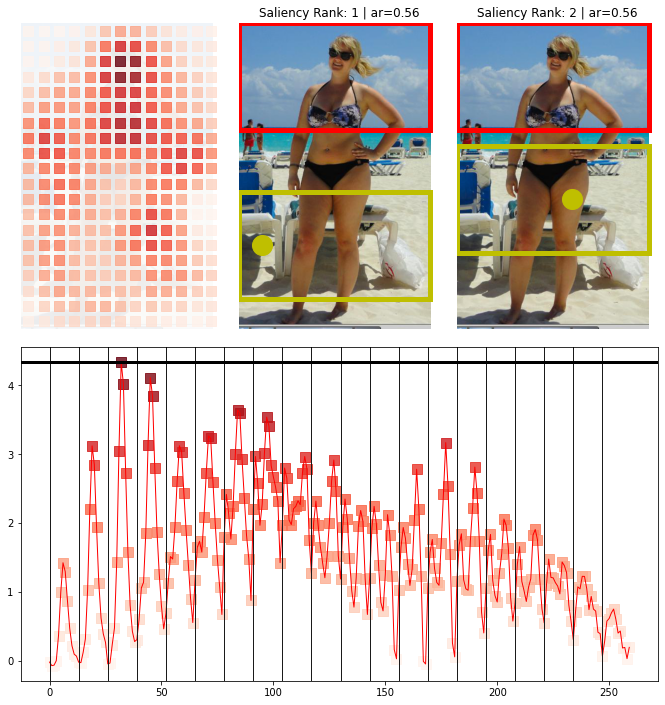

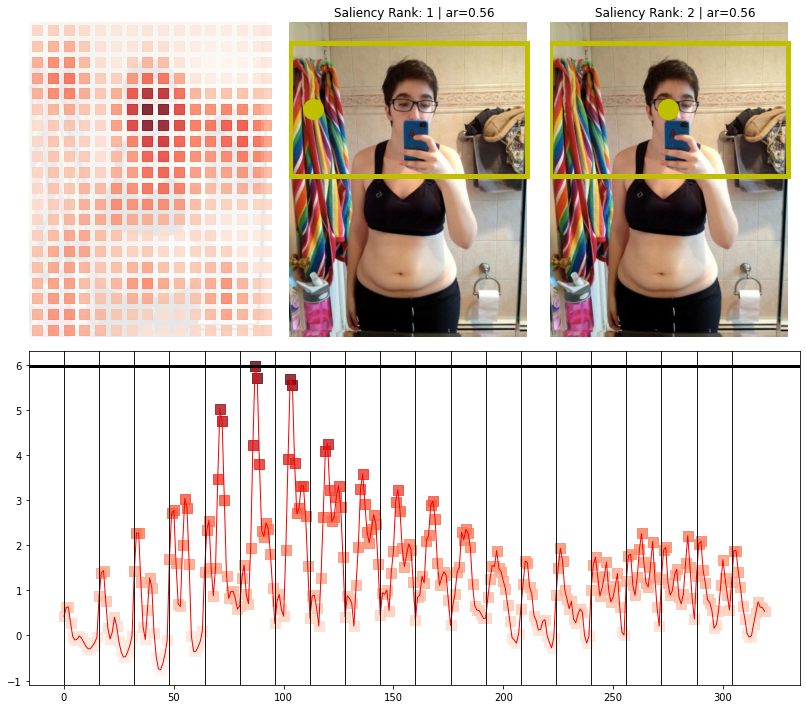

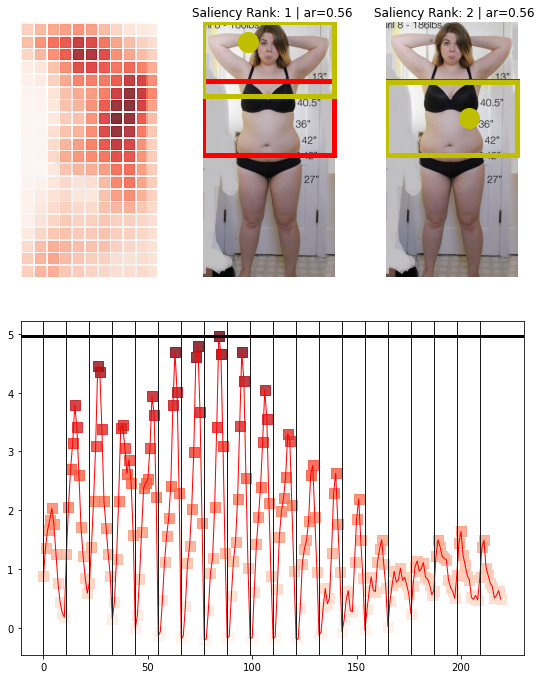

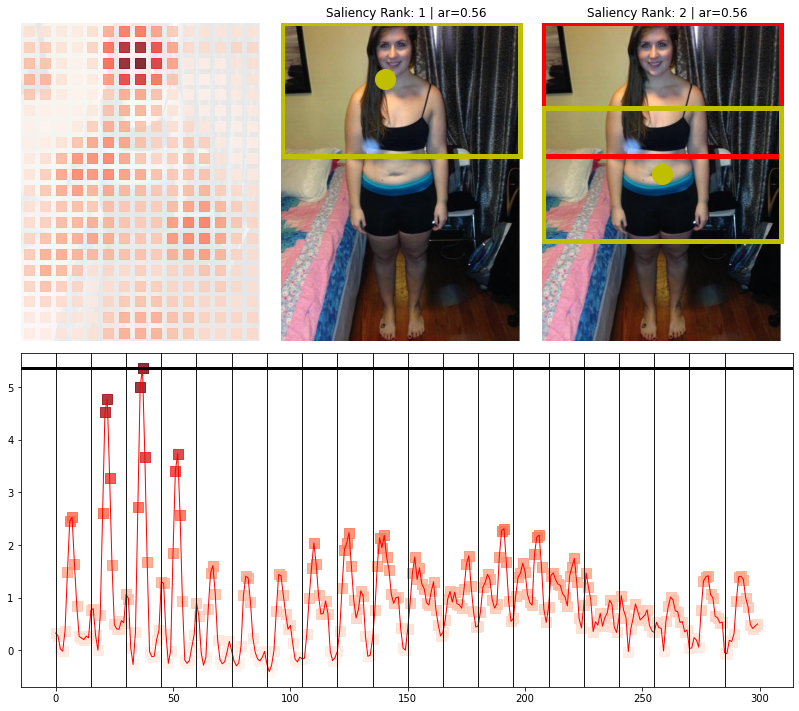

...

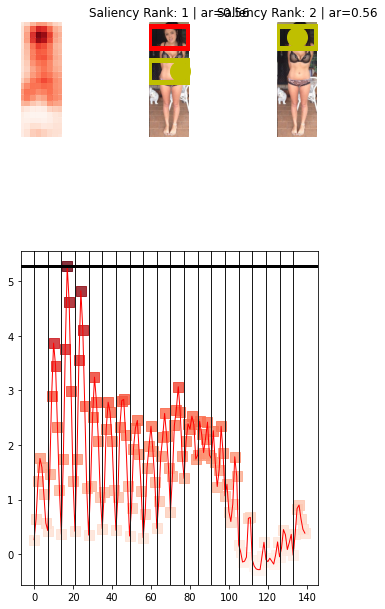

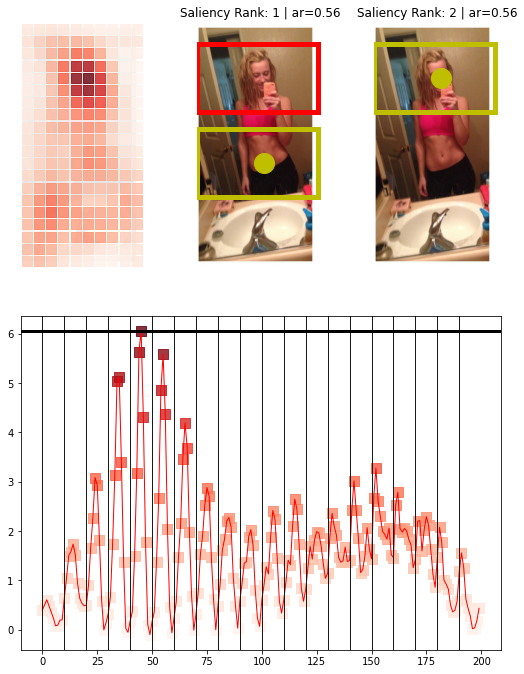

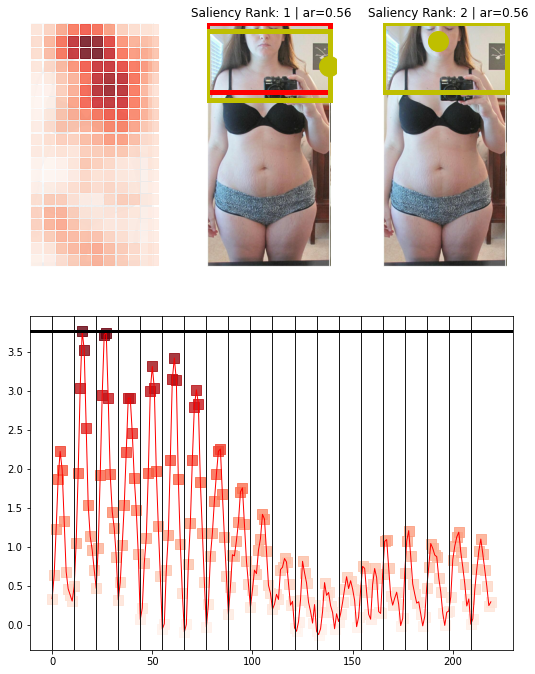

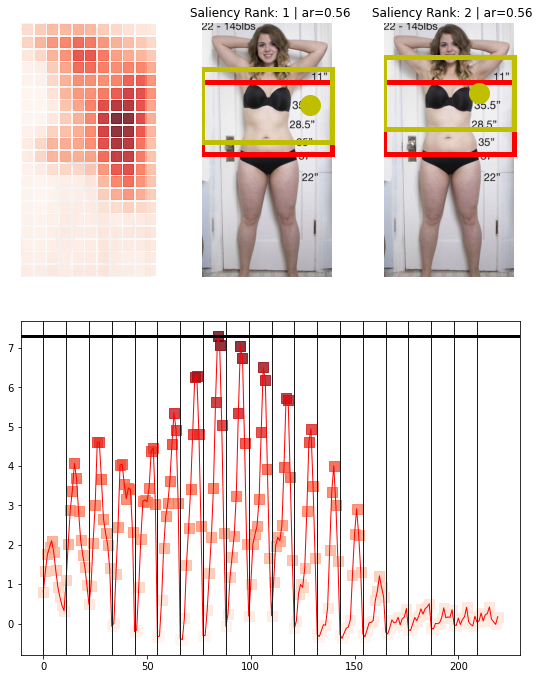

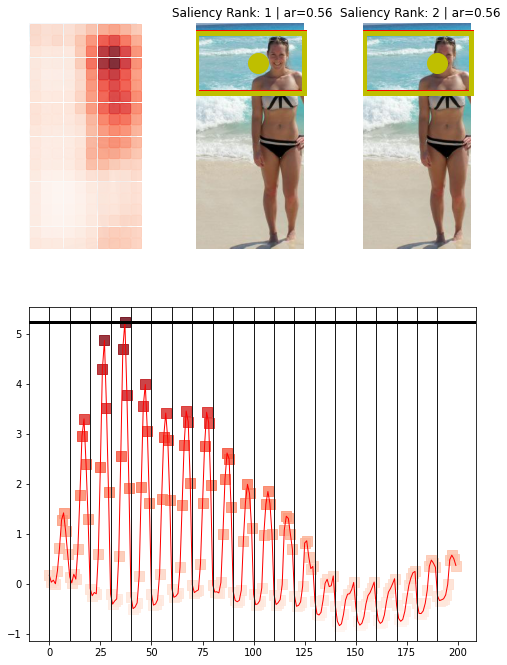

In [35]:
# For Female Not Fully Clothed Images
task = "female-not-fully-clothed"

print(len(fnfc))

for img in fnfc:
    get_gaze_analysis(img)

In [42]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
!zip -r image-crop-analysis-results.zip /content/image-crop-analysis-results

  adding: content/image-crop-analysis-results/ (stored 0%)
  adding: content/image-crop-analysis-results/black-male-white-male-guns_1487.jpg_184.jpg.jpeg (deflated 16%)
  adding: content/image-crop-analysis-results/black-female-handcuff-luxury-watches_263.jpg_263.jpg.jpeg (deflated 12%)
  adding: content/image-crop-analysis-results/black-male-handcuff-luxury-watches_1487.jpg_1487.jpg.jpeg (deflated 14%)
  adding: content/image-crop-analysis-results/black-female-white-female-guns_1282.jpg_785.jpg.jpeg (deflated 13%)
  adding: content/image-crop-analysis-results/black-male-white-male-guns_1286.jpg_6.jpg.jpeg (deflated 13%)
  adding: content/image-crop-analysis-results/black-female-white-female-original_1172.jpg_162.jpg.jpeg (deflated 14%)
  adding: content/image-crop-analysis-results/black-male-white-male-original_1476.jpg_543.jpg.jpeg (deflated 13%)
  adding: content/image-crop-analysis-results/black-female-white-female-original_289.jpg_1240.jpg.jpeg (deflated 13%)
  adding: content/ima

In [5]:
!zip -r male-gaze-analysis-results.zip /content/male-gaze-analysis-results

  adding: content/male-gaze-analysis-results/ (stored 0%)
  adding: content/male-gaze-analysis-results/female-fully-clothed_1qq733_zII0M4I_145_66_true_536_1.22.jpg.jpeg (deflated 10%)
  adding: content/male-gaze-analysis-results/male-fully-clothed_1bv421_EFguGi3_275_74_false_35_1.33.jpg.jpeg (deflated 17%)
  adding: content/male-gaze-analysis-results/female-not-fully-clothed_1tcrus_KmAk0MM_186_66_true_982_0.5.jpg.jpeg (deflated 9%)
  adding: content/male-gaze-analysis-results/male-fully-clothed_1ixfby_CMn5OB7_210_69_false_19_1.33.jpg.jpeg (deflated 13%)
  adding: content/male-gaze-analysis-results/female-not-fully-clothed_1qba5c_z0qpWMu_200_68_true_504_1.48.jpg.jpeg (deflated 11%)
  adding: content/male-gaze-analysis-results/male-not-fully-clothed_1cqr78_WxXz9eD_267_70_false_85_0.56.jpg.jpeg (deflated 12%)
  adding: content/male-gaze-analysis-results/female-fully-clothed_1shh6q_IQwyHvN_350_67_true_166_1.41.jpg.jpeg (deflated 9%)
  adding: content/male-gaze-analysis-results/female-not-f

In [6]:
!cp /content/image-crop-analysis-results.zip /content/drive/MyDrive/twitter-image-crop/
!cp /content/male-gaze-analysis-results.zip /content/drive/MyDrive/twitter-image-crop/